# Importing libraries

In [2]:
import pandas as pd
import numpy as np
import sklearn
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
import json


Bad key "text.kerning_factor" on line 4 in
/home/atishay/anaconda3/lib/python3.8/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution


In [3]:
import bs4 as bs
import pickle
import requests
import datetime as dt
import os
import plotly
import plotly.figure_factory as ff
import plotly.offline as pyo
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly import tools
from collections import Counter
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import svm, neighbors
from sklearn.naive_bayes import GaussianNB

# Covid Data

## Redundant_code_covid1

In [5]:
if os.path.exists(os.path.join(os.getcwd(), "covid19", "data", "all_totals.json")):
    print("yes")

yes


In [6]:
covid_data_path = os.path.join(os.getcwd(), "covid19", "data", "all_totals.json")
with open(covid_data_path, 'r') as j:
     covid_data_dict = json.loads(j.read())

In [7]:
covid_data = np.array(covid_data_dict['rows'])
active_cases_array = covid_data[::4]
cured_array = covid_data[1::4]
death_array = covid_data[2::4]
total_confirmed_cases_array = covid_data[3::4]
covid_data_dict1 = {"date":[], "active_cases":[], "cured":[], "death":[], "total_confirmed_cases":[]}
for i in range(0, len(active_cases_array)):
    covid_data_dict1["date"].append(active_cases_array[i]['key'][0])
    covid_data_dict1["active_cases"].append(active_cases_array[i]['value'])
    covid_data_dict1["cured"].append(cured_array[i]['value'])
    covid_data_dict1["death"].append(death_array[i]['value'])
    covid_data_dict1["total_confirmed_cases"].append(total_confirmed_cases_array[i]['value'])

In [8]:
covid_data1 = pd.DataFrame(covid_data_dict1)
covid_data1

,date,active_cases,cured,death,total_confirmed_cases
0,2020-01-30T13:33:00.00+05:30,1,0,0,1
1,2020-02-02T10:39:00.00+05:30,2,0,0,2
2,2020-02-03T12:13:00.00+05:30,3,0,0,3
3,2020-03-02T14:28:00.00+05:30,5,0,0,5
4,2020-03-03T19:36:00.00+05:30,6,0,0,6
...,...,...,...,...,...
776,2022-02-19T08:00:00.00+05:30,253739,42037536,511230,42802505
777,2022-02-20T08:00:00.00+05:30,224187,42086383,511903,42822473
778,2022-02-21T08:00:00.00+05:30,202131,42124284,512109,42838524
779,2022-02-22T08:00:00.00+05:30,181075,42158510,512344,42851929


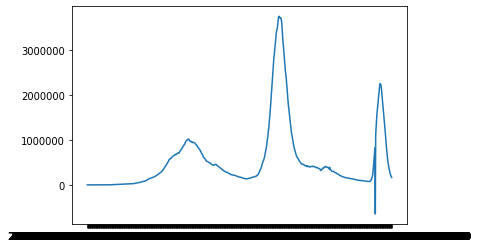

In [9]:
plt.plot(covid_data1["date"], covid_data1["active_cases"])

## Fetching covid data 
The following attributes are fetched :- 
* date
* total_cases
* new_cases
* new_deaths
* new_tests
* reproduction_rate
* positive_rate
* total_vaccinations
* people_vaccinated
* people_fully_vaccinated
* new_vaccinations
* stringency_index (The stringency index is a composite measure based on nine response indicators including school closures, workplace closures, and travel bans, rescaled to a value from 0 to 100 (100 = strictest))
* covid_medicines_trend
* covid_19_trend

In [5]:
# Reading covid data
covid_data2 = pd.read_csv("/home/atishay/Desktop/6th_SEM/Predictive_Analysis/Project/code/Covid_data/owid-covid-data.csv")
# covid_data2 = pd.read_csv("/home/atishay/Downloads/new_covid_data.csv")

In [6]:
# Selecting important attributes for India
covid_data2 = covid_data2.loc[covid_data2["iso_code"] == "IND"]
covid_data2 = pd.DataFrame({"date" : covid_data2["date"],
                            "total_cases" : covid_data2["total_cases"],
                            "new_cases" : covid_data2["new_cases"], 
                            "new_deaths" : covid_data2["new_deaths"], 
                            "new_tests" : covid_data2["new_tests"], 
                            "reproduction_rate" : covid_data2["reproduction_rate"],
                            "positive_rate" : covid_data2["positive_rate"], 
                            "total_vaccinations" : covid_data2["total_vaccinations"], 
                            "people_vaccinated" : covid_data2["people_vaccinated"], 
                            "people_fully_vaccinated" : covid_data2["people_fully_vaccinated"], 
                            "new_vaccinations" : covid_data2["new_vaccinations"], 
                            "stringency_index" : covid_data2["stringency_index"]})

In [7]:
# Sicing data with a given date range

covid_data2 = covid_data2.reset_index(drop=True)
covid_data2.drop(labels = range(0,45), axis = 0, inplace = True)
covid_data2.drop(labels = range(751,757), axis = 0, inplace = True)
covid_data2 = covid_data2.reset_index(drop=True)

# covid_data2 = covid_data2.reset_index(drop=True)
# covid_data2.drop(labels = range(0,31), axis = 0, inplace = True)
# covid_data2.drop(labels = range(751,812), axis = 0, inplace = True)
# covid_data2 = covid_data2.reset_index(drop=True)

In [8]:
# Fetching google trends data 
df_c_1 = pd.read_csv("/home/atishay/Desktop/6th_SEM/Predictive_Analysis/Project/code/Covid_data/google_trends/covid_19_1.csv")
df_c_2 = pd.read_csv("/home/atishay/Desktop/6th_SEM/Predictive_Analysis/Project/code/Covid_data/google_trends/covid_19_2.csv")
df_c_3 = pd.read_csv("/home/atishay/Desktop/6th_SEM/Predictive_Analysis/Project/code/Covid_data/google_trends/covid_19_3.csv")

df_m_1 = pd.read_csv("/home/atishay/Desktop/6th_SEM/Predictive_Analysis/Project/code/Covid_data/google_trends/covid_medicines_1.csv")
df_m_2 = pd.read_csv("/home/atishay/Desktop/6th_SEM/Predictive_Analysis/Project/code/Covid_data/google_trends/covid_medicines_2.csv")
df_m_3 = pd.read_csv("/home/atishay/Desktop/6th_SEM/Predictive_Analysis/Project/code/Covid_data/google_trends/covid_medicines_3.csv")

df_covid_19_trend = pd.concat([df_c_1, df_c_2, df_c_3])
df_covid_medicines_trend = pd.concat([df_m_1, df_m_2, df_m_3])

df_covid_19_trend = df_covid_19_trend.iloc[15:]
df_covid_medicines_trend = df_covid_medicines_trend.iloc[15:]

In [9]:
covid_medicines_trend = []
for i in df_covid_medicines_trend["Category: All categories"]:
    if(i == 'covid medicines: (India)'):
        pass
    else:
        covid_medicines_trend.append(int(i))

In [10]:
covid_19_trend = []
for i in df_covid_19_trend["Category: All categories"]:
    if(i == 'covid 19: (India)'):
        pass
    else:
        covid_19_trend.append(int(i))

In [11]:
covid_data2["covid_medicines_trend"] = covid_medicines_trend
covid_data2["covid_19_trend"] = covid_19_trend

In [12]:
import datetime

data2_date = []
for i in covid_data2["date"]:
    date_str = i
    date_time_obj = datetime.datetime.strptime(date_str, '%Y-%m-%d')
    data2_date.append(date_time_obj)
covid_data2["date"] = data2_date

In [13]:
# Checking date consistency in covid_data1 and covid_data2
import datetime
start_date = datetime.date(2020, 3, 15)
end_date = datetime.date(2022, 2, 18)
    
def check_date_consistency(start_date, end_date, covid_data_df):
    
    date_list = []
    delta = end_date - start_date       # as timedelta
    for i in range(delta.days + 1):
        day = start_date + datetime.timedelta(days=i)
        date_list.append(day)
            
    for i, date_instance in enumerate(covid_data_df["date"].tolist()):
        if(date_instance != date_list[i]):
            print(date_instance, date_list[i])
    
check_date_consistency(start_date, end_date, covid_data2)

## Dealing with missing values in pandas dataframe

* New Deaths :- Filled missing values present in the beginning(first 10 rows) with 0, while the missing value of index 452 was filled with the mean of adjecant new death values.
* New Tests :- Filling the first 4 missing values according to the positivity rate on the 6th day and the new cases detected in the first 4 days. Filling the missing values from day of index 11 to day of index 18 from https://ourworldindata.org/. The rest of the missing values were filled using 2nd degree polynomial interpolation.
* Stringency Index :- Filling the missing data from https://covid.ourworldindata.org/data/owid-covid-data.csv

In [13]:
# Filling null values in new_deaths column :- 
covid_data2["new_deaths"].iloc[452] = (covid_data2["new_deaths"].iloc[451] + covid_data2["new_deaths"].iloc[453])/2

In [14]:
# Filling null values in new_tests column :- 
for i in range(0, 4):
    covid_data2["new_tests"].iloc[i] = covid_data2["new_cases"].iloc[i] * (100/covid_data2["positive_rate"].iloc[5])

# Manually filling in missing data from https://ourworldindata.org/
covid_data2["new_tests"].iloc[11] = 31960
covid_data2["new_tests"].iloc[12] = 33388
covid_data2["new_tests"].iloc[13] = 36302
covid_data2["new_tests"].iloc[14] = 41312
covid_data2["new_tests"].iloc[15] = 47094
covid_data2["new_tests"].iloc[16] = 51552
covid_data2["new_tests"].iloc[17] = 63059
covid_data2["new_tests"].iloc[18] = 60163

covid_data2["new_tests"] = covid_data2["new_tests"].interpolate(method='polynomial', order=2)

In [15]:
# Filling in Filling null values in positive_rate column :- 
for i in range(0, 5):
    covid_data2["positive_rate"].iloc[i] = covid_data2["positive_rate"].iloc[5]

In [16]:
# Stringence index
stringency_index_missing_values = [75.46,75.46,75.46,75.46,75.46,75.46,75.46,71.76,71.76,71.76,71.76]
stringency_index_missing_index = [695, 696, 697, 698, 699, 700, 701, 702, 703, 704, 705]
for i, stringency_index in enumerate(stringency_index_missing_index):
    covid_data2["stringency_index"].iloc[stringency_index] = stringency_index_missing_values[i]

In [17]:
vaccinaton1 = ["total_vaccinations", "people_vaccinated", "new_vaccinations"]
for col in vaccinaton1:
    for i in range(0, 306):
        covid_data2[col].iloc[i] = 0
    
covid_data2["new_vaccinations"].iloc[306] = 0

for i in range(0, 335):
    covid_data2["people_fully_vaccinated"].iloc[i] = 0
    
covid_data2["new_vaccinations"] = covid_data2["new_vaccinations"].interpolate() # Linear interpolation
for i in range(0, len(covid_data2)):
    covid_data2["new_vaccinations"].iloc[i] = int(covid_data2["new_vaccinations"].iloc[i])
    
for i in range(0, len(covid_data2)):
    if(np.isnan(covid_data2["total_vaccinations"].iloc[i])):
        covid_data2["total_vaccinations"].iloc[i] = covid_data2["total_vaccinations"].iloc[i-1] + covid_data2["new_vaccinations"].iloc[i-1]

covid_data2["people_vaccinated"] = covid_data2["people_vaccinated"].interpolate() # Linear interpolation
for i in range(0, len(covid_data2)):
    covid_data2["people_vaccinated"].iloc[i] = int(covid_data2["people_vaccinated"].iloc[i])
    
covid_data2["people_fully_vaccinated"] = covid_data2["people_fully_vaccinated"].interpolate() # Linear interpolation
for i in range(0, len(covid_data2)):
    covid_data2["people_fully_vaccinated"].iloc[i] = int(covid_data2["people_fully_vaccinated"].iloc[i])
    

In [18]:
covid_data2.columns

Index(['date', 'total_cases', 'new_cases', 'new_deaths', 'new_tests',
       'reproduction_rate', 'positive_rate', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'new_vaccinations',
       'stringency_index', 'covid_medicines_trend', 'covid_19_trend'],
      dtype='object')

In [19]:
for col in covid_data2.columns:
    null_sum = covid_data2[col].isnull().sum()
    if(null_sum > 0):
        print(f"Total number of missing values in {col} are {null_sum}")
        print(covid_data2[covid_data2[col].isnull()].index.tolist())

## Smoothing out variables 

In [20]:
# Smoothing attributes like new_deaths because of irregular spikes

def simple_sliding_window_moving_average(arr, window_size):
  
    i = 0
    moving_averages = []

    while(i < len(arr)-window_size+1):
        window_average = round(np.sum(arr[i:i+window_size]) / window_size)
        moving_averages.append(window_average)
        i += 1

    while(i<len(arr)):
        moving_averages.append(window_average)
        i += 1
        
    return moving_averages

In [21]:
covid_data2.columns

Index(['date', 'total_cases', 'new_cases', 'new_deaths', 'new_tests',
       'reproduction_rate', 'positive_rate', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'new_vaccinations',
       'stringency_index', 'covid_medicines_trend', 'covid_19_trend'],
      dtype='object')

In [22]:
new_deaths_smoothed = simple_sliding_window_moving_average(arr = covid_data2["new_deaths"], window_size = 7)
covid_data2["new_deaths_smoothed"] = new_deaths_smoothed

In [23]:
new_cases_smoothed = simple_sliding_window_moving_average(arr = covid_data2["new_cases"], window_size = 7)
covid_data2["new_cases_smoothed"] = new_cases_smoothed

In [24]:
new_tests_smoothed = simple_sliding_window_moving_average(arr = covid_data2["new_tests"], window_size = 7)
covid_data2["new_tests_smoothed"] = new_tests_smoothed

In [25]:
positive_rate_smoothed = simple_sliding_window_moving_average(arr = covid_data2["positive_rate"], window_size = 7)
covid_data2["positive_rate_smoothed"] = positive_rate_smoothed

In [26]:
new_vaccinations_smoothed = simple_sliding_window_moving_average(arr = covid_data2["new_vaccinations"], window_size = 7)
covid_data2["new_vaccinations_smoothed"] = new_vaccinations_smoothed

## Visualizing covid data

In [28]:
import plotly
import plotly.express as px

In [29]:
import plotly.express as px
fig = px.line(covid_data2, x='date', y='new_cases', markers=True)
fig.show()

In [30]:
fig = px.line(covid_data2, x='date', y=['new_deaths', 'new_deaths_smoothed'])
fig.update_layout(
    font_family="Courier New",
    font_color="blue",
    title_font_family="Times New Roman",
    title_font_color="red",
    legend_title_font_color="green",
    xaxis_title="Date",
    yaxis_title="Covid Deaths",
)
fig.show()

In [31]:
fig = px.line(covid_data2, x='date', y=['new_cases', 'new_cases_smoothed'])
fig.update_layout(
    font_family="Courier New",
    font_color="blue",
    title_font_family="Times New Roman",
    title_font_color="red",
    legend_title_font_color="green",
    xaxis_title="Date",
    yaxis_title="Covid Cases",
)
fig.show()

In [32]:
fig = px.line(covid_data2, x='date', y=['new_tests', 'new_tests_smoothed'])
fig.show()

In [30]:
fig = px.line(covid_data2, x='date', y='stringency_index')
fig.show()

In [34]:
fig = px.line(covid_data2, x='date', y='covid_19_trend')
fig.show()

In [35]:
fig = px.line(covid_data2, x='date', y='covid_medicines_trend')
fig.show()

## Adding a new variable like "change in new cases"

In [31]:
covid_data2.columns

Index(['date', 'total_cases', 'new_cases', 'new_deaths', 'new_tests',
       'reproduction_rate', 'positive_rate', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated', 'new_vaccinations',
       'stringency_index', 'covid_medicines_trend', 'covid_19_trend',
       'new_deaths_smoothed', 'new_cases_smoothed', 'new_tests_smoothed',
       'positive_rate_smoothed', 'new_vaccinations_smoothed'],
      dtype='object')

In [32]:
l = [100, 110 , 120, 130, 120]
l = pd.Series(l)

In [33]:
l.diff()

0     NaN
1    10.0
2    10.0
3    10.0
4   -10.0
dtype: float64

In [34]:
delta_new_cases = covid_data2["new_cases"].diff()
delta_new_cases[0] = 0
covid_data2["delta_new_cases"] = delta_new_cases

In [35]:
delta_new_cases_smoothed = covid_data2["new_cases_smoothed"].diff()
delta_new_cases_smoothed[0] = 0
covid_data2["delta_new_cases_smoothed"] = delta_new_cases_smoothed

In [36]:
delta_new_deaths = covid_data2["new_deaths"].diff()
delta_new_deaths[0] = 0
covid_data2["delta_new_deaths"] = delta_new_deaths

In [37]:
delta_new_deaths_smoothed = covid_data2["new_deaths_smoothed"].diff()
delta_new_deaths_smoothed[0] = 0
covid_data2["delta_new_deaths_smoothed"] = delta_new_deaths_smoothed

In [38]:
delta_reproduction_rate = covid_data2["reproduction_rate"].diff()
delta_reproduction_rate[0] = 0
covid_data2["delta_reproduction_rate"] = delta_reproduction_rate

In [39]:
delta_positive_rate = covid_data2["positive_rate"].diff()
delta_positive_rate[0] = 0
covid_data2["delta_positive_rate"] = delta_positive_rate

In [40]:
delta_new_vaccinations = covid_data2["new_vaccinations"].diff()
delta_new_vaccinations[0] = 0
covid_data2["delta_new_vaccinations"] = delta_new_vaccinations

In [41]:
delta_new_vaccinations_smoothed = covid_data2["new_vaccinations_smoothed"].diff()
delta_new_vaccinations_smoothed[0] = 0
covid_data2["delta_new_vaccinations_smoothed"] = delta_new_vaccinations_smoothed

In [42]:
for i in range(400, 420):
    print(covid_data2["new_vaccinations"].iloc[i], covid_data2["delta_new_vaccinations"].iloc[i], covid_data2["new_vaccinations"].diff()[i])

3276547.0 2046571.0 2046571.0
3220532.0 -56015.0 -56015.0
3164517.0 -56015.0 -56015.0
3108503.0 -56014.0 -56014.0
3166320.0 57817.0 57817.0
3224138.0 57818.0 57818.0
3281956.0 57818.0 57818.0
3339774.0 57818.0 57818.0
2354286.0 -985488.0 -985488.0
2174159.0 -180127.0 -180127.0
2215380.0 41221.0 41221.0
2729335.0 513955.0 513955.0
1628218.0 -1101117.0 -1101117.0
585186.0 -1043032.0 -1043032.0
1870625.0 1285439.0 1285439.0
1668616.0 -202009.0 -202009.0
2180486.0 511870.0 511870.0
2672365.0 491879.0 491879.0
2586397.0 -85968.0 -85968.0
2303857.0 -282540.0 -282540.0


In [43]:
fig = px.line(x=covid_data2['date'], y=covid_data2.delta_new_vaccinations, markers=True)
fig.show()

In [49]:
fig = px.line(x=covid_data2['date'], y=new_vaccinations_smoothed, markers=True)
fig.show()

## Dropping unnecessary columns

In [44]:
covid_data2.drop(['new_deaths', 'new_cases', 'new_tests', 'new_vaccinations'], axis = 1, inplace = True)

In [45]:
covid_data2.columns

Index(['date', 'total_cases', 'reproduction_rate', 'positive_rate',
       'total_vaccinations', 'people_vaccinated', 'people_fully_vaccinated',
       'stringency_index', 'covid_medicines_trend', 'covid_19_trend',
       'new_deaths_smoothed', 'new_cases_smoothed', 'new_tests_smoothed',
       'positive_rate_smoothed', 'new_vaccinations_smoothed',
       'delta_new_cases', 'delta_new_cases_smoothed', 'delta_new_deaths',
       'delta_new_deaths_smoothed', 'delta_reproduction_rate',
       'delta_positive_rate', 'delta_new_vaccinations',
       'delta_new_vaccinations_smoothed'],
      dtype='object')

# Financial Data

## Fetching Financial Data

In [46]:
# Getting pharamaceutical stock data
st_df = {}
st_names = []
csv_names = os.listdir(os.path.join(os.getcwd(), "nifty_data"))
csv_names.sort()
for i, st in enumerate(csv_names):
    st_name = st[24:].split(".csv")[0]
    if(st_name in st_names):
        df = pd.read_csv(os.path.join(os.getcwd(), "nifty_data", st))
        for j, name in enumerate(st_names):
            if(name == st_name):
                break
        st_df[j] = st_df[j].append(df)
    else: 
        st_names.append(st_name)
        df = pd.read_csv(os.path.join(os.getcwd(), "nifty_data", st))
        st_df[i] = df

In [47]:
# Printing the starting and last date of the financial dataset
for i, df in st_df.items():
    print(df.Date.iloc[0], df.Date.iloc[-1])

02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022
02-Mar-2020 18-Feb-2022


## Converting into date format

In [48]:
# Converting month abbreviations into numbers
import calendar
month_num_dict = {month: index for index, month in enumerate(calendar.month_abbr) if month}
for i, df in st_df.items():
    date_l = []
    for date in df.Date:
        month_num = month_num_dict[date.split('-')[1]]
        date_l.append(f"{date.split('-')[0]}-{month_num}-{date.split('-')[2]}")
    df.Date = date_l

In [49]:
import datetime

for i, df in st_df.items():
    datetime_date = []
    for date in df["Date"]:
        date_str = date
        date_time_obj = datetime.datetime.strptime(date_str, '%d-%m-%Y')
        datetime_date.append(date_time_obj)
    df["Date"] = datetime_date

In [50]:
type(st_df[0].Date.iloc[0])

pandas._libs.tslibs.timestamps.Timestamp

In [51]:
# Checking date consistency in stock data
import datetime
start_date = datetime.date(2020, 3, 1)
end_date = datetime.date(2022, 2, 18)
    
def check_date_consistency(start_date, end_date, stock_df):
    
    missing_dates = []
    date_list = []
    delta = end_date - start_date       # as timedelta
    for i in range(delta.days + 1):
        day = start_date + datetime.timedelta(days=i)
        date_list.append(day)
            
    for i in date_list:
        if(i not in stock_df["Date"].tolist()):
            missing_dates.append(i)
    
    return missing_dates

In [52]:
missing_dates_list = []
for i in range(0, len(st_df)):
    missing_dates = check_date_consistency(start_date, end_date, st_df[i])
    missing_dates_list.append(missing_dates)

In [53]:
for i in range(0, len(st_df)):
    print(len(st_df[i]), len(missing_dates_list[i]))

491 229
491 229
491 229
493 229
492 229
492 229
491 229
492 229
491 229
491 229
492 229
491 229
492 229
491 229
493 229
496 229
492 229
491 229
491 229


In [54]:
def check_dates_between_stocks(st_df):
    for i in range(0, len(st_df)-1):
        for j in range(i+1, len(st_df)):
            df1 = st_df[i]
            df2 = st_df[j]
            print(f"The difference in dates between {st_df[i]['Symbol'].iloc[0]} and {st_df[j]['Symbol'].iloc[0]} are of :-")
            for date in st_df[i]["Date"]:
                if(date not in st_df[j]["Date"].tolist()):
                    print(date)

In [61]:
check_dates_between_stocks(st_df)

The difference in dates between ABBOTINDIA and ALKEM are of :-
The difference in dates between ABBOTINDIA and APLLTD are of :-
The difference in dates between ABBOTINDIA and AUROPHARMA are of :-
The difference in dates between ABBOTINDIA and BIOCON are of :-
The difference in dates between ABBOTINDIA and CIPLA are of :-
The difference in dates between ABBOTINDIA and DIVISLAB are of :-
The difference in dates between ABBOTINDIA and DRREDDY are of :-
The difference in dates between ABBOTINDIA and GLENMARK are of :-
The difference in dates between ABBOTINDIA and GRANULES are of :-
The difference in dates between ABBOTINDIA and IPCALAB are of :-
The difference in dates between ABBOTINDIA and LAURUSLABS are of :-
The difference in dates between ABBOTINDIA and LUPIN are of :-
The difference in dates between ABBOTINDIA and NATCOPHARM are of :-
The difference in dates between ABBOTINDIA and STAR are of :-
The difference in dates between ABBOTINDIA and SUNPHARMA are of :-
The difference in date

The difference in dates between GRANULES and SUNPHARMA are of :-
The difference in dates between GRANULES and TORNTPHARM are of :-
The difference in dates between GRANULES and CADILAHC are of :-
The difference in dates between GRANULES and PFIZER are of :-
The difference in dates between IPCALAB and LAURUSLABS are of :-
The difference in dates between IPCALAB and LUPIN are of :-
The difference in dates between IPCALAB and NATCOPHARM are of :-
The difference in dates between IPCALAB and STAR are of :-
The difference in dates between IPCALAB and SUNPHARMA are of :-
The difference in dates between IPCALAB and TORNTPHARM are of :-
The difference in dates between IPCALAB and CADILAHC are of :-
The difference in dates between IPCALAB and PFIZER are of :-
The difference in dates between LAURUSLABS and LUPIN are of :-
The difference in dates between LAURUSLABS and NATCOPHARM are of :-
The difference in dates between LAURUSLABS and STAR are of :-
The difference in dates between LAURUSLABS and S

In [62]:
inc = []
for date in st_df[2].Date:
#     print(date)
    if(date in st_df[3].Date):
        inc.append(date)
        
for i in range(0, len(st_df[2])):
    if(st_df[2].Date.iloc[i] == st_df[3].Date.iloc[i]):
        pass
    else:
        print(st_df[2].Date.iloc[i], st_df[3].Date.iloc[i])


2021-04-08 00:00:00 2021-04-07 00:00:00
2021-04-09 00:00:00 2021-04-08 00:00:00
2021-04-12 00:00:00 2021-04-09 00:00:00
2021-04-13 00:00:00 2021-04-12 00:00:00
2021-04-15 00:00:00 2021-04-13 00:00:00
2021-04-16 00:00:00 2021-04-15 00:00:00
2021-04-19 00:00:00 2021-04-16 00:00:00
2021-04-20 00:00:00 2021-04-19 00:00:00
2021-04-22 00:00:00 2021-04-20 00:00:00
2021-04-23 00:00:00 2021-04-22 00:00:00
2021-04-26 00:00:00 2021-04-23 00:00:00
2021-04-27 00:00:00 2021-04-26 00:00:00
2021-04-28 00:00:00 2021-04-27 00:00:00
2021-04-29 00:00:00 2021-04-28 00:00:00
2021-04-30 00:00:00 2021-04-29 00:00:00
2021-05-03 00:00:00 2021-04-30 00:00:00
2021-05-04 00:00:00 2021-05-03 00:00:00
2021-05-05 00:00:00 2021-05-04 00:00:00
2021-05-06 00:00:00 2021-05-05 00:00:00
2021-05-07 00:00:00 2021-05-06 00:00:00
2021-05-10 00:00:00 2021-05-07 00:00:00
2021-05-11 00:00:00 2021-05-10 00:00:00
2021-05-12 00:00:00 2021-05-11 00:00:00
2021-05-14 00:00:00 2021-05-12 00:00:00
2021-05-17 00:00:00 2021-05-14 00:00:00


## Plotting Financial Data

In [55]:
def candlestick(date_from, date_to, df):
                    
    
    start_index = np.where(df.Date == date_from)[0][0]
    end_index = np.where(df.Date == date_to)[0][0]
    df = df.iloc[start_index : end_index + 1]
    
    fig = go.Figure()
    
    fig.add_trace(go.Candlestick(x = df.Date,
                                 open = df["Open Price"],
                                 close = df["Close Price"],
                                 high = df["High Price"],
                                 low = df["Low Price"]))
    
    fig.update_layout(title = "Candlestick graph of " + str(df.Symbol.iloc[0]),
                      yaxis_title = str(name) + " stock price",
                      xaxis_title = "Date",
                      font=dict(size=18, color="RebeccaPurple"))
    
    fig.show()
    

In [56]:
candlestick(date_from = st_df[0].Date.iloc[0],date_to = st_df[0].Date.iloc[-1], df = st_df[0])

In [65]:
candlestick(date_from = st_df[1].Date.iloc[0],date_to = st_df[0].Date.iloc[-1], df = st_df[0])

## Adding financial columns 

12AM----------------9:15AM(O)--------------5PM(C)-------------------12PM-----CD-------------------------------12AM

* Opening(n+1) - Closing(n) {On the basis of nth day's covid data}
* Thus predicting the opening price of tomorrows stock market on the basis of today's closing price and covid data

* Predicting volume traded based on today's covid data

In [57]:
def add_financial_columns(stock_df_dict):
    
    for i, df in stock_df_dict.items():
        
        df["High-Low"] = df['High Price'] - df['Low Price']
        df["Oprice-Pclose"] = df['Open Price'] - df['Prev Close']
        df["close-open"] = df['Close Price'] - df['Open Price']
        
        # Stores binary values indicating whether the opening price is higher or lower than previous closing price
        binary_oc = df["Oprice-Pclose"] > 0
        binary_oc = binary_oc.astype(int)
        df["binary-Oprice-Pclose"] = binary_oc
        
        # Stores binary values indicating whether the current day closing price is higher or lower than current day opening price
        binary_co = df["close-open"] > 0
        binary_co = binary_co.astype(int)
        df["binary-close-open"] = binary_co
        
        stock_df_dict[i] = df
        
    return stock_df_dict
        

In [58]:
st_df = add_financial_columns(stock_df_dict = st_df)

## Removing financial columns

In [59]:
def drop_financial_columns(stock_df_dict):
    
    for i, df in stock_df_dict.items():
        
        df.drop(['Series', 'Prev Close', 'Open Price', 'High Price', 'Low Price', 'Last Price', 'Close Price', 
                 'Total Traded Quantity', 'Turnover', 'Deliverable Qty', '% Dly Qt to Traded Qty'], 
                 axis = 1, inplace = True)
        
        stock_df_dict[i] = df
        
    return stock_df_dict

In [60]:
st_df = drop_financial_columns(stock_df_dict = st_df)

## Merging covid and pharma data

In [61]:
covid_data2.rename(columns = {'date':'Date'}, inplace = True)

In [64]:
# We will be creating a dictionary containing dataframes for each stock with combined data of stock and covid data

def merge_covid_stock(covid_df, stock_data_dict):
    
    merged_dict = {}
    
    for i, stock_df in stock_data_dict.items(): # Looping through each stock dataframe
        stock_name = stock_df["Symbol"].iloc[0]
        merged_df = pd.merge(covid_df, stock_df, on='Date', how='left')
        merged_dict[stock_name] = merged_df
        
#         stock_dict = {} # Modified dataframe for each stock dataframe with null values for days with no data
#         for st_col in stock_df.columns: # Creating a list for each column
#             st_col_list = []
#             stock_index = 0
#             for covid_index in range(0, len(covid_df)): # looping through each covid data sample
#                 if(covid_df.date.iloc[covid_index] in stock_df.Date.tolist()): # The data for that date is present in both stock as well as covid dataframme
#                     st_col_list.append(stock_df[st_col].iloc[stock_index])
#                     stock_index += 1
#                 else: # The data for that date is not present in the stock dataframe
#                     st_col_list.append(np.nan)
#             stock_dict[st_col] = st_col_list
#         merged_dict[stock_name] = pd.DataFrame(stock_dict) # Dataframe containing the modified stock data with null values for dates with no stock data
        
    
    return merged_dict

In [65]:
merged_dict = merge_covid_stock(covid_df = covid_data2, stock_data_dict = st_df)

In [66]:
# Printing the starting and last date of the merged dataset
for i, df in merged_dict.items():
    print(df.Date.iloc[0], df.Date.iloc[-1])

2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00
2020-03-15 00:00:00 2022-02-18 00:00:00


# Working on Combined Covid and Pharma Data

## Dealing with delta covid data when weekend comes in between 

In [67]:
df = merged_dict['ABBOTINDIA']
len(merged_dict['ABBOTINDIA'])

706

In [68]:
def account_weekend_change(merged_dict, covid_delta_columns):
    
    for st, df in merged_dict.items():
        
        for col in covid_delta_columns:
            weekend_accounted_col = []
            buffer = 0
            prev_na = 0
            for i in range(0, len(df[col])):
                if(df["Average Price"].isna().tolist()[i] == True): # NA Value
                    buffer += df[col].iloc[i]
                    prev_na = 1
                    weekend_accounted_col.append(df[col].iloc[i])
                else:
                    if(prev_na == 1): # The previous value was an NA value
                        buffer += df[col].iloc[i]
                        weekend_accounted_col.append(buffer)
                        buffer = 0
                        prev_na = 0
                    else:
                        weekend_accounted_col.append(df[col].iloc[i])
            df[col] = weekend_accounted_col
            
        merged_dict[st] = df
            
        
    return merged_dict
        

In [69]:
covid_delta_columns = ['delta_new_cases', 'delta_new_cases_smoothed', 'delta_new_deaths',
       'delta_new_deaths_smoothed', 'delta_reproduction_rate',
       'delta_positive_rate', 'delta_new_vaccinations',
       'delta_new_vaccinations_smoothed']

In [70]:
merged_dict = account_weekend_change(merged_dict, covid_delta_columns)

### Verificaton

In [275]:
df["Average Price"].isna().tolist()[:20]

[True,
 False,
 False,
 False,
 False,
 False,
 True,
 True,
 False,
 False,
 False,
 False,
 False,
 True,
 True,
 False,
 False,
 False,
 True,
 False]

In [233]:
df["delta_new_cases"].iloc[:20]

0       0.0
1      -5.0
2      17.0
3      -9.0
4      24.0
5      12.0
6      36.0
7     -20.0
8      53.0
9     -66.0
10     84.0
11    -51.0
12     90.0
13    -60.0
14    -63.0
15     67.0
16    -81.0
17    455.0
18    -56.0
19   -577.0
Name: delta_new_cases, dtype: float64

In [318]:
merged_dict["ABBOTINDIA"]["delta_new_cases"].iloc[:20]

0       0.0
1      -5.0
2      17.0
3      -9.0
4      24.0
5      12.0
6      36.0
7     -20.0
8      53.0
9     -66.0
10     84.0
11    -51.0
12     90.0
13    -60.0
14    -63.0
15     67.0
16    -81.0
17    455.0
18    -56.0
19   -577.0
Name: delta_new_cases, dtype: float64

## Dropping rows with NA values

In [71]:
def drop_NA_rows(merged_dict):
    
    for st, df in merged_dict.items():
        df = df.dropna()
        merged_dict[st] = df
    
    return merged_dict

In [72]:
merged_dict = drop_NA_rows(merged_dict)

In [73]:
merged_dict

{'ABBOTINDIA':           Date  total_cases  reproduction_rate  positive_rate  \
 1   2020-03-16        119.0               1.48         0.0206   
 2   2020-03-17        142.0               1.66         0.0206   
 3   2020-03-18        156.0               1.79         0.0206   
 4   2020-03-19        194.0               2.05         0.0206   
 5   2020-03-20        244.0               2.25         0.0206   
 ..         ...          ...                ...            ...   
 701 2022-02-14   42692943.0               0.39         0.0345   
 702 2022-02-15   42723558.0               0.37         0.0309   
 703 2022-02-16   42754315.0               0.36         0.0288   
 704 2022-02-17   42780235.0               0.35         0.0261   
 705 2022-02-18   42802505.0               0.34         0.0240   
 
      total_vaccinations  people_vaccinated  people_fully_vaccinated  \
 1          0.000000e+00                0.0                      0.0   
 2          0.000000e+00                0.0     

In [74]:
merged_dict['ABBOTINDIA']

,Date,total_cases,reproduction_rate,positive_rate,total_vaccinations,people_vaccinated,people_fully_vaccinated,stringency_index,covid_medicines_trend,covid_19_trend,...,delta_new_vaccinations,delta_new_vaccinations_smoothed,Symbol,Average Price,No. of Trades,High-Low,Oprice-Pclose,close-open,binary-Oprice-Pclose,binary-close-open
1,2020-03-16,119.0,1.48,0.0206,0.000000e+00,0.0,0.0,48.15,0,17,...,0.0,0.0,ABBOTINDIA,14444.91,5932.0,700.00,-73.95,-478.45,0.0,0.0
2,2020-03-17,142.0,1.66,0.0206,0.000000e+00,0.0,0.0,48.15,14,21,...,0.0,0.0,ABBOTINDIA,14846.13,5468.0,935.10,3.45,479.65,1.0,1.0
3,2020-03-18,156.0,1.79,0.0206,0.000000e+00,0.0,0.0,50.00,0,24,...,0.0,0.0,ABBOTINDIA,14359.54,8669.0,1549.00,50.30,-716.15,1.0,0.0
4,2020-03-19,194.0,2.05,0.0206,0.000000e+00,0.0,0.0,59.72,56,31,...,0.0,0.0,ABBOTINDIA,13282.77,10277.0,1318.55,-738.80,-250.70,0.0,0.0
5,2020-03-20,244.0,2.25,0.0206,0.000000e+00,0.0,0.0,70.83,14,39,...,0.0,0.0,ABBOTINDIA,14307.02,8477.0,1979.75,50.85,1436.65,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
701,2022-02-14,42692943.0,0.39,0.0345,1.729730e+09,958462316.0,754746231.0,75.46,9,26,...,-7956853.0,-824215.0,ABBOTINDIA,16202.45,7679.0,341.15,-319.05,-80.50,0.0,0.0
702,2022-02-15,42723558.0,0.37,0.0309,1.736069e+09,959602131.0,759530099.0,71.76,9,28,...,4521590.0,0.0,ABBOTINDIA,16322.46,5776.0,488.70,62.50,264.80,1.0,1.0
703,2022-02-16,42754315.0,0.36,0.0288,1.738650e+09,960091888.0,761473602.0,71.76,0,28,...,-3757742.0,0.0,ABBOTINDIA,16982.88,19964.0,753.95,69.20,458.20,1.0,1.0
704,2022-02-17,42780235.0,0.35,0.0261,1.743932e+09,961022242.0,765507484.0,71.76,9,28,...,2700235.0,0.0,ABBOTINDIA,16866.89,7642.0,583.25,0.00,-229.90,0.0,0.0


In [75]:
merged_dict['ABBOTINDIA'].isna().sum()

Date                               0
total_cases                        0
reproduction_rate                  0
positive_rate                      0
total_vaccinations                 0
people_vaccinated                  0
people_fully_vaccinated            0
stringency_index                   0
covid_medicines_trend              0
covid_19_trend                     0
new_deaths_smoothed                0
new_cases_smoothed                 0
new_tests_smoothed                 0
positive_rate_smoothed             0
new_vaccinations_smoothed          0
delta_new_cases                    0
delta_new_cases_smoothed           0
delta_new_deaths                   0
delta_new_deaths_smoothed          0
delta_reproduction_rate            0
delta_positive_rate                0
delta_new_vaccinations             0
delta_new_vaccinations_smoothed    0
Symbol                             0
Average Price                      0
No. of Trades                      0
High-Low                           0
O

## Using logs of data

In [76]:
import math 
import copy 

def get_logged_dict(merged_dict):
    
    features_to_log = ['total_cases', 'total_vaccinations', 'people_vaccinated', 'people_fully_vaccinated', 
                       'new_deaths_smoothed', 'new_cases_smoothed', 'new_tests_smoothed', 'new_vaccinations_smoothed',
                       'delta_new_cases', 'delta_new_cases_smoothed', 'delta_new_deaths', 
                       'delta_new_deaths_smoothed', 'delta_new_vaccinations', 'delta_new_vaccinations_smoothed']
      
    merged_dict_logged = copy.deepcopy(merged_dict)
    
    for st_name, df in merged_dict_logged.items():
        for col in features_to_log:
            for i in range(0, len(df)):
                if(df[col].iloc[i] < 1):
                    if(df[col].iloc[i] < 0):
                        df[col].iloc[i] = -math.log10(-df[col].iloc[i])
                    elif(df[col].iloc[i] >=0): #i.e = 0
                        df[col].iloc[i] = 0
                else:
                    df[col].iloc[i] = math.log10(df[col].iloc[i])
                    
    return merged_dict_logged

In [77]:
merged_dict_logged = get_logged_dict(merged_dict)

In [78]:
merged_dict_logged

{'ABBOTINDIA':           Date  total_cases  reproduction_rate  positive_rate  \
 1   2020-03-16     2.075547               1.48         0.0206   
 2   2020-03-17     2.152288               1.66         0.0206   
 3   2020-03-18     2.193125               1.79         0.0206   
 4   2020-03-19     2.287802               2.05         0.0206   
 5   2020-03-20     2.387390               2.25         0.0206   
 ..         ...          ...                ...            ...   
 701 2022-02-14     7.630356               0.39         0.0345   
 702 2022-02-15     7.630667               0.37         0.0309   
 703 2022-02-16     7.630980               0.36         0.0288   
 704 2022-02-17     7.631243               0.35         0.0261   
 705 2022-02-18     7.631469               0.34         0.0240   
 
      total_vaccinations  people_vaccinated  people_fully_vaccinated  \
 1              0.000000           0.000000                 0.000000   
 2              0.000000           0.000000     

### Visualizing logged data

In [330]:
fig = px.line(merged_dict["APLLTD"], x='Date', y=['Oprice-Pclose', 'delta_new_cases'])
fig.update_layout(
    font_family="Courier New",
    font_color="blue",
    title_font_family="Times New Roman",
    title_font_color="red",
    legend_title_font_color="green",
    xaxis_title="Date",
    yaxis_title="Covid Deaths",
)
fig.show()

In [331]:
fig = px.line(merged_dict_logged["APLLTD"], x='Date', y='delta_new_cases', markers=True)
fig.show()

In [332]:
import plotly.express as px
fig = px.line(merged_dict_logged['ABBOTINDIA'], x='Date', y='new_cases_smoothed', markers=True)
fig.show()

## Data Normalization

In [81]:
drop_cols = ['Date', 'Symbol', 'No. of Trades', 'Average Price', 'High-Low', 'Oprice-Pclose', 'close-open',
           'binary-Oprice-Pclose', 'binary-close-open']

standardized_cols = []

for col in merged_dict['ABBOTINDIA'].columns:
    if col not in drop_cols:
        standardized_cols.append(col)

In [82]:
standardized_cols

['total_cases',
 'reproduction_rate',
 'positive_rate',
 'total_vaccinations',
 'people_vaccinated',
 'people_fully_vaccinated',
 'stringency_index',
 'covid_medicines_trend',
 'covid_19_trend',
 'new_deaths_smoothed',
 'new_cases_smoothed',
 'new_tests_smoothed',
 'positive_rate_smoothed',
 'new_vaccinations_smoothed',
 'delta_new_cases',
 'delta_new_cases_smoothed',
 'delta_new_deaths',
 'delta_new_deaths_smoothed',
 'delta_reproduction_rate',
 'delta_positive_rate',
 'delta_new_vaccinations',
 'delta_new_vaccinations_smoothed']

In [83]:
# Returning a merged dictionary of normalized dataframes, i.e. with the covid features being normalized

from sklearn import preprocessing

def standardize_features(merged_dict):
        
    drop_cols = ['Date', 'Symbol', 'No. of Trades', 'Average Price', 'High-Low', 'Oprice-Pclose', 'close-open',
           'binary-Oprice-Pclose', 'binary-close-open']

    standardized_cols = []
    for col in merged_dict['ABBOTINDIA'].columns:
        if col not in drop_cols:
            standardized_cols.append(col)
    
    standardized_merged_dict = copy.deepcopy(merged_dict)
    
    for st_name, df in standardized_merged_dict.items():
        
        X = df.drop(drop_cols, axis = 1)
        
        scaler = preprocessing.StandardScaler()
        fit = scaler.fit(X)
        X_scaled = fit.transform(X)
        
        df_scaled = pd.DataFrame(X_scaled, columns = standardized_cols)
        df.reset_index(inplace = True, drop = True)
        for col in df_scaled:
            df[col] = df_scaled[col]
        
    return standardized_merged_dict

In [84]:
standardized_merged_dict = standardize_features(merged_dict)

In [85]:
standardized_logged_merged_dict = standardize_features(merged_dict_logged)

## Feature selection

### Method 1 :- Boruta Algorithm

In [285]:
from sklearn.ensemble import RandomForestClassifier
from boruta import BorutaPy
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score 

In [286]:
df = merged_dict['ABBOTINDIA']

In [287]:
df.columns

Index(['Date', 'total_cases', 'reproduction_rate', 'positive_rate',
       'total_vaccinations', 'people_vaccinated', 'people_fully_vaccinated',
       'stringency_index', 'covid_medicines_trend', 'covid_19_trend',
       'new_deaths_smoothed', 'new_cases_smoothed', 'new_tests_smoothed',
       'positive_rate_smoothed', 'new_vaccinations_smoothed',
       'delta_new_cases', 'delta_new_cases_smoothed', 'delta_new_deaths',
       'delta_new_deaths_smoothed', 'delta_reproduction_rate',
       'delta_positive_rate', 'delta_new_vaccinations',
       'delta_new_vaccinations_smoothed', 'Symbol', 'Average Price',
       'No. of Trades', 'High-Low', 'Oprice-Pclose', 'close-open',
       'binary-Oprice-Pclose', 'binary-close-open'],
      dtype='object')

In [93]:
X = df.drop(['Date', 'Symbol', 'No. of Trades', 'Average Price', 'High-Low', 'Oprice-Pclose', 'close-open',
       'binary-Oprice-Pclose', 'binary-close-open'], axis = 1)
y = df['binary-Oprice-Pclose']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .2, random_state = 1) 

# Creating a baseline RandomForrestClassifier model with all the features.

rf_all_features = GaussianNB()
rf_all_features.fit(X_train, y_train) 

accuracy_score(y_test, rf_all_features.predict(X_test))


# Creating a BorutaPy object with RandomForestClassifier as the estimator and ranking the features. 
# One important thing to note here is that Boruta works on NumPy arrays only

rfc = GaussianNB()
boruta_selector = BorutaPy(rfc, n_estimators='auto', verbose=2, random_state=1)
boruta_selector.fit(np.array(X_train), np.array(y_train))  

# BorutaPy object created with RandomForestClassifier as the estimator
print("Ranking: ",boruta_selector.ranking_)          
print("No. of significant features: ", boruta_selector.n_features_) 

# Let’s create a table and see exactly what features were rejected.

selected_rf_features = pd.DataFrame({'Feature':list(X_train.columns),
                                   'Ranking':boruta_selector.ranking_})
selected_rf_features.sort_values(by='Ranking') 

# Using the BorutaPy object to transform the features in the dfset.
X_important_train = boruta_selector.transform(np.array(X_train))
X_important_test = boruta_selector.transform(np.array(X_test)) 

# Creating another RandomForestClassifier model with the same parameters as the baseline classifier and training it with the selected features.

rf_boruta = GaussianNB()
rf_boruta.fit(X_important_train, y_train) 

accuracy_score(y_test, rf_boruta.predict(X_important_test))

KeyError: 'max_depth'

### Method 2 :- Forward selection

In [93]:
#importing the necessary libraries
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.linear_model import LinearRegression

In [94]:
def get_forward_features(merged_dict, k_features = 10, cv = 10):
    
    sfs = SFS(GaussianNB(),
              k_features=10,
              forward=True,
              scoring = 'accuracy',
              cv = 10)
    
    forward_features_merged = {}
    
    for st_name, df in merged_dict.items():
        X = df.drop(['Date', 'Symbol', 'No. of Trades', 'Average Price', 'High-Low', 'Oprice-Pclose', 'close-open',
           'binary-Oprice-Pclose', 'binary-close-open'], axis = 1)
        y = df['binary-Oprice-Pclose']
        sfs.fit(X, y)
        forward_features_merged[st_name] = list(sfs.k_feature_names_)
    
    return forward_features_merged

In [95]:
forward_features_standardized_merged = get_forward_features(merged_dict, k_features = 10, cv = 10)

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/skl

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/skl

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/skl

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/skl

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:453: RuntimeWarning:

invalid value encountered in true_divide

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/naive_bayes.py:452: RuntimeWarning:

divide by zero encountered in log

/home/atishay/anaconda3/lib/python3.8/site-packages/skl

In [96]:
forward_features_standardized_merged

{'ABBOTINDIA': ['total_cases',
  'reproduction_rate',
  'positive_rate',
  'stringency_index',
  'covid_medicines_trend',
  'covid_19_trend',
  'positive_rate_smoothed',
  'delta_new_deaths_smoothed',
  'delta_reproduction_rate',
  'delta_positive_rate'],
 'ALKEM': ['reproduction_rate',
  'positive_rate',
  'total_vaccinations',
  'stringency_index',
  'covid_medicines_trend',
  'covid_19_trend',
  'new_tests_smoothed',
  'positive_rate_smoothed',
  'delta_reproduction_rate',
  'delta_positive_rate'],
 'APLLTD': ['reproduction_rate',
  'positive_rate',
  'people_fully_vaccinated',
  'stringency_index',
  'covid_medicines_trend',
  'covid_19_trend',
  'new_tests_smoothed',
  'positive_rate_smoothed',
  'delta_reproduction_rate',
  'delta_positive_rate'],
 'AUROPHARMA': ['total_cases',
  'reproduction_rate',
  'positive_rate',
  'people_vaccinated',
  'stringency_index',
  'covid_medicines_trend',
  'covid_19_trend',
  'new_deaths_smoothed',
  'new_tests_smoothed',
  'positive_rate_smoot

In [97]:
merged_dict['ABBOTINDIA']

,Date,total_cases,reproduction_rate,positive_rate,total_vaccinations,people_vaccinated,people_fully_vaccinated,stringency_index,covid_medicines_trend,covid_19_trend,...,delta_new_vaccinations,delta_new_vaccinations_smoothed,Symbol,Average Price,No. of Trades,High-Low,Oprice-Pclose,close-open,binary-Oprice-Pclose,binary-close-open
1,2020-03-16,119.0,1.48,0.0206,0.000000e+00,0.0,0.0,48.15,0,17,...,0.0,0.0,ABBOTINDIA,14444.91,5932.0,700.00,-73.95,-478.45,0.0,0.0
2,2020-03-17,142.0,1.66,0.0206,0.000000e+00,0.0,0.0,48.15,14,21,...,0.0,0.0,ABBOTINDIA,14846.13,5468.0,935.10,3.45,479.65,1.0,1.0
3,2020-03-18,156.0,1.79,0.0206,0.000000e+00,0.0,0.0,50.00,0,24,...,0.0,0.0,ABBOTINDIA,14359.54,8669.0,1549.00,50.30,-716.15,1.0,0.0
4,2020-03-19,194.0,2.05,0.0206,0.000000e+00,0.0,0.0,59.72,56,31,...,0.0,0.0,ABBOTINDIA,13282.77,10277.0,1318.55,-738.80,-250.70,0.0,0.0
5,2020-03-20,244.0,2.25,0.0206,0.000000e+00,0.0,0.0,70.83,14,39,...,0.0,0.0,ABBOTINDIA,14307.02,8477.0,1979.75,50.85,1436.65,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
701,2022-02-14,42692943.0,0.39,0.0345,1.729730e+09,958462316.0,754746231.0,75.46,9,26,...,-7956853.0,-824215.0,ABBOTINDIA,16202.45,7679.0,341.15,-319.05,-80.50,0.0,0.0
702,2022-02-15,42723558.0,0.37,0.0309,1.736069e+09,959602131.0,759530099.0,71.76,9,28,...,4521590.0,0.0,ABBOTINDIA,16322.46,5776.0,488.70,62.50,264.80,1.0,1.0
703,2022-02-16,42754315.0,0.36,0.0288,1.738650e+09,960091888.0,761473602.0,71.76,0,28,...,-3757742.0,0.0,ABBOTINDIA,16982.88,19964.0,753.95,69.20,458.20,1.0,1.0
704,2022-02-17,42780235.0,0.35,0.0261,1.743932e+09,961022242.0,765507484.0,71.76,9,28,...,2700235.0,0.0,ABBOTINDIA,16866.89,7642.0,583.25,0.00,-229.90,0.0,0.0


### Backward Selection

In [98]:
df = merged_dict['ABBOTINDIA']
X = df.drop(['Date', 'Symbol', 'No. of Trades', 'Average Price', 'High-Low', 'Oprice-Pclose', 'close-open',
           'binary-Oprice-Pclose', 'binary-close-open'], axis = 1)
y = df['binary-Oprice-Pclose']

In [99]:
#Sequential backward selection(sbs)
sbs = SFS(LogisticRegression(),
         k_features=11,
         forward=False,
         floating=False,
         cv=0)

In [100]:
sbs.fit(X, y)

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

SequentialFeatureSelector(cv=0, estimator=LogisticRegression(), forward=False,
                          k_features=11)

In [101]:
backward_selection_features = list(sbs.k_feature_names_)

In [102]:
backward_selection_features

['total_cases',
 'reproduction_rate',
 'positive_rate',
 'total_vaccinations',
 'people_vaccinated',
 'stringency_index',
 'covid_19_trend',
 'new_cases_smoothed',
 'new_tests_smoothed',
 'delta_new_cases',
 'delta_new_cases_smoothed']

## Getting correlation

In [86]:
merged_dict["ABBOTINDIA"].columns

Index(['Date', 'total_cases', 'reproduction_rate', 'positive_rate',
       'total_vaccinations', 'people_vaccinated', 'people_fully_vaccinated',
       'stringency_index', 'covid_medicines_trend', 'covid_19_trend',
       'new_deaths_smoothed', 'new_cases_smoothed', 'new_tests_smoothed',
       'positive_rate_smoothed', 'new_vaccinations_smoothed',
       'delta_new_cases', 'delta_new_cases_smoothed', 'delta_new_deaths',
       'delta_new_deaths_smoothed', 'delta_reproduction_rate',
       'delta_positive_rate', 'delta_new_vaccinations',
       'delta_new_vaccinations_smoothed', 'Symbol', 'Average Price',
       'No. of Trades', 'High-Low', 'Oprice-Pclose', 'close-open',
       'binary-Oprice-Pclose', 'binary-close-open'],
      dtype='object')

In [87]:
def get_correlation(merged_dict):
    
    corr_dict = {}
    
    for st, df in merged_dict.items():
        
        df = df.drop(['Date', 'Symbol'], axis = 1)
        
        corr_dict[st] = df.corr()
        
    return corr_dict

In [88]:
corr_dict = get_correlation(merged_dict)

In [89]:
import seaborn as sb
def get_corr_heatmap(corr_dict, Symbol):
    f = plt.figure()
    f.set_figwidth(20)
    f.set_figheight(20)
    dataplot = sb.heatmap(corr_dict[Symbol], cmap="YlGnBu", annot=True)
    plt.show
    plt.savefig('my_plot.png')

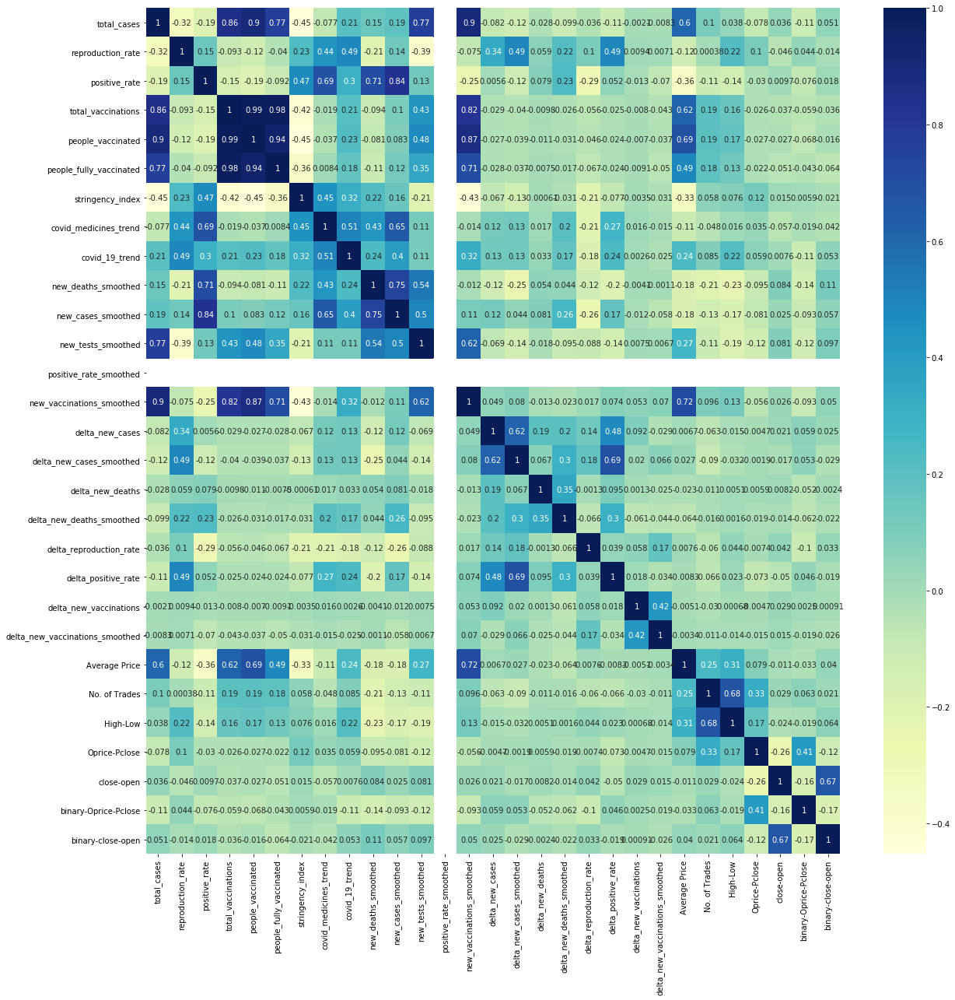

In [90]:
get_corr_heatmap(corr_dict, Symbol = "ABBOTINDIA")

# Model Creation

### Importing necessary libraries

In [91]:
import math

def get_log(df, feature_list):
    
    for col in feature_list:
        for i in range(0, len(df)):
            if(df[col].iloc[i] < 1): # i.e = 0
                df[col].iloc[i] = -2
            else:
                df[col].iloc[i] = math.log10(df[col].iloc[i])
        
    return df

In [104]:
df_logged = get_log(df, feature_list = backward_selection_features)

In [105]:
def get_df(df, selected_features, target_variable, test_size = 0.2, shuffle=False):
    
    X = df[selected_features]
    y = df[target_variable]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, shuffle=False)
    
    return X, y, X_train, X_test, y_train, y_test
    

In [106]:
from sklearn                        import metrics, svm
from sklearn.linear_model           import LinearRegression
from sklearn.linear_model           import LogisticRegression
from sklearn.tree                   import DecisionTreeClassifier
from sklearn.neighbors              import KNeighborsClassifier
from sklearn.discriminant_analysis  import LinearDiscriminantAnalysis
from sklearn.naive_bayes            import GaussianNB
from sklearn.svm                    import SVC
from sklearn.metrics                import accuracy_score

In [107]:
X, y, X_train, X_test, y_train, y_test = get_df(df_logged, selected_features = backward_selection_features, target_variable = 'binary-Oprice-Pclose')

In [108]:
def get_results(merged_dict, features, target_variable = 'binary-Oprice-Pclose'):
    
    Symbol = []
    LogisticRegression_results = []
    DecisionTreeClassifier_results = []
    KNeighborsClassifier_results = []
    LinearDiscriminantAnalysis_results = []
    GaussianNB_results = []
    SVC_results = []
    
    for st, df in merged_dict.items():
        
        Symbol.append(st)

        X, y, X_train, X_test, y_train, y_test = get_df(df = df, 
                                                        selected_features = features, 
                                                        target_variable = target_variable)

        classfier = LogisticRegression()
        classfier.fit(X_train, y_train)
        y_pred = classfier.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        LogisticRegression_results.append(accuracy*100)


        classfier = DecisionTreeClassifier()
        classfier.fit(X_train, y_train)
        y_pred = classfier.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        DecisionTreeClassifier_results.append(accuracy*100)

        classfier = KNeighborsClassifier()
        classfier.fit(X_train, y_train)
        y_pred = classfier.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        KNeighborsClassifier_results.append(accuracy*100)

        classfier = LinearDiscriminantAnalysis()
        classfier.fit(X_train, y_train)
        y_pred = classfier.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        LinearDiscriminantAnalysis_results.append(accuracy*100)

        classfier = GaussianNB()
        classfier.fit(X_train, y_train)
        y_pred = classfier.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        GaussianNB_results.append(accuracy*100)

        classfier = SVC()
        classfier.fit(X_train, y_train)
        y_pred = classfier.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        SVC_results.append(accuracy*100)
        
    Symbol.append("Combined")
    LogisticRegression_results.append(np.mean(LogisticRegression_results))
    DecisionTreeClassifier_results.append(np.mean(DecisionTreeClassifier_results))
    KNeighborsClassifier_results.append(np.mean(KNeighborsClassifier_results))
    LinearDiscriminantAnalysis_results.append(np.mean(LinearDiscriminantAnalysis_results))
    GaussianNB_results.append(np.mean(GaussianNB_results))
    SVC_results.append(np.mean(SVC_results))
        
    dict_results = {'Symbol':Symbol, 
                    'LogisticRegression':LogisticRegression_results, 
                    'DecisionTreeClassifier': DecisionTreeClassifier_results,
                    'KNeighborsClassifier':KNeighborsClassifier_results,
                    'LinearDiscriminantAnalysis':LinearDiscriminantAnalysis_results,
                    'GaussianNB':GaussianNB_results,
                    'SVC':SVC_results}
    
    return pd.DataFrame(dict_results)

In [109]:
backward_feature_selection_results_df = get_results(merged_dict = merged_dict, features = backward_selection_features, target_variable = 'binary-Oprice-Pclose')

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [110]:
backward_feature_selection_results_df

,Symbol,LogisticRegression,DecisionTreeClassifier,KNeighborsClassifier,LinearDiscriminantAnalysis,GaussianNB,SVC
0,ABBOTINDIA,56.701031,51.546392,57.731959,31.958763,52.577320,68.041237
1,ALKEM,54.639175,43.298969,54.639175,46.391753,45.360825,54.639175
2,APLLTD,45.360825,45.360825,48.453608,48.453608,48.453608,48.453608
3,AUROPHARMA,28.865979,28.865979,28.865979,28.865979,51.546392,71.134021
4,BIOCON,61.855670,54.639175,40.206186,40.206186,50.515464,59.793814
5,CIPLA,34.020619,64.948454,36.082474,36.082474,36.082474,57.731959
6,DIVISLAB,67.010309,44.329897,67.010309,67.010309,40.206186,67.010309
7,DRREDDY,57.731959,59.793814,57.731959,41.237113,42.268041,57.731959
8,GLENMARK,60.824742,57.731959,60.824742,60.824742,60.824742,60.824742
9,GRANULES,60.824742,53.608247,60.824742,53.608247,39.175258,60.824742


## Visualizing different features to develop a better understanding of correlation

In [186]:
fig = px.line(merged_dict["APLLTD"], x='Date', y=['Oprice-Pclose', 'delta_new_cases'])
fig.update_layout(
    font_family="Courier New",
    font_color="blue",
    title_font_family="Times New Roman",
    title_font_color="red",
    legend_title_font_color="green",
    xaxis_title="Date",
    yaxis_title="Covid Deaths",
)
fig.show()

In [187]:
fig = px.line(merged_dict["APLLTD"], x='Date', y='delta_new_cases', markers=True)
fig.show()

In [188]:
fig = px.line(merged_dict["APLLTD"], x='Date', y='Oprice-Pclose', markers=True)
fig.show()

In [189]:
fig = px.line(merged_dict["APLLTD"], x='Date', y='covid_19_trend', markers=True)
fig.show()

In [192]:
import plotly.express as px
fig = px.line(merged_dict['ABBOTINDIA'], x='Date', y='new_cases_smoothed', markers=True)
fig.show()

In [191]:
fig = px.line(merged_dict['ABBOTINDIA'][30:], x='Date', y='Oprice-Pclose', markers=True)
fig.show()

# Working on time divided combined covid and pharma data

## Dividing data into timeframes

In [111]:
def create_time_divided_merged_dict(merged_dict, time_period = 30):
    
    time_divided_merged_dict = {}
    
    for df_name, df in merged_dict.items():
        
        num_interval = len(df)/time_period
        num_interval = round(num_interval+0.5)
        
        start_index = 0
        
        time_divided_dict = {}
        
        for i in range(0, num_interval-1):
            time_divided_dict[f'{df.Date.iloc[start_index]}-{df.Date.iloc[start_index+time_period]}'] = df.iloc[start_index:start_index+time_period]
            start_index += time_period
        time_divided_dict[f'{df.Date.iloc[start_index]}-{df.Date.iloc[-1]}'] = df.iloc[start_index:-1]
        
        time_divided_merged_dict[df_name] = time_divided_dict
        
    return time_divided_merged_dict

In [112]:
time_divided_merged_dict = create_time_divided_merged_dict(merged_dict, time_period = 30)

In [113]:
time_divided_merged_dict

{'ABBOTINDIA': {'2020-03-16 00:00:00-2020-05-04 00:00:00':          Date  total_cases  reproduction_rate  positive_rate  \
  1  2020-03-16     2.075547           0.170262           -2.0   
  2  2020-03-17     2.152288           0.220108           -2.0   
  3  2020-03-18     2.193125           0.252853           -2.0   
  4  2020-03-19     2.287802           0.311754           -2.0   
  5  2020-03-20     2.387390           0.352183           -2.0   
  8  2020-03-23     2.698101           0.346353           -2.0   
  9  2020-03-24     2.729165           0.322219           -2.0   
  10 2020-03-25     2.817565           0.315970           -2.0   
  11 2020-03-26     2.861534           0.307496           -2.0   
  12 2020-03-27     2.947924           0.318063           -2.0   
  15 2020-03-30     3.097257           0.365488           -2.0   
  16 2020-03-31     3.145196           0.396199           -2.0   
  17 2020-04-01     3.300595           0.429752           -2.0   
  19 2020-04-03    

## Getting logs of data

In [114]:
import math 
import copy 

def get_time_divided_logged_dict(time_divided_merged_dict):
    
    features_to_log = ['total_cases', 'total_vaccinations', 'people_vaccinated', 'people_fully_vaccinated', 
                       'new_deaths_smoothed', 'new_cases_smoothed', 'new_tests_smoothed', 'new_vaccinations_smoothed',
                       'delta_new_cases', 'delta_new_cases_smoothed', 'delta_new_deaths', 
                       'delta_new_deaths_smoothed', 'delta_new_vaccinations', 'delta_new_vaccinations_smoothed']
      
    time_divided_logged_merged_dict = copy.deepcopy(time_divided_merged_dict)
    
    print(time_divided_logged_merged_dict)
    
    for st_name, st_dict in time_divided_logged_merged_dict.items():
        
        for date_range, df in st_dict.items():
            
#             print(df)

            for col in features_to_log:
                for i in range(0, len(df)):
#                     print(df[col].iloc[i])
                    if(df[col].iloc[i] < 1):
                        if(df[col].iloc[i] < 0):
                            df[col].iloc[i] = -math.log10(-df[col].iloc[i])
                        elif(df[col].iloc[i] >=0): #i.e = 0
                            df[col].iloc[i] = 0
                    else:
                        df[col].iloc[i] = math.log10(df[col].iloc[i])
                    
    return time_divided_logged_merged_dict

In [115]:
time_divided_logged_merged_dict = get_time_divided_logged_dict(time_divided_merged_dict)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [116]:
time_divided_logged_merged_dict

{'ABBOTINDIA': {'2020-03-16 00:00:00-2020-05-04 00:00:00':          Date  total_cases  reproduction_rate  positive_rate  \
  1  2020-03-16     0.317133           0.170262           -2.0   
  2  2020-03-17     0.332900           0.220108           -2.0   
  3  2020-03-18     0.341063           0.252853           -2.0   
  4  2020-03-19     0.359418           0.311754           -2.0   
  5  2020-03-20     0.377923           0.352183           -2.0   
  8  2020-03-23     0.431058           0.346353           -2.0   
  9  2020-03-24     0.436030           0.322219           -2.0   
  10 2020-03-25     0.449874           0.315970           -2.0   
  11 2020-03-26     0.456599           0.307496           -2.0   
  12 2020-03-27     0.469516           0.318063           -2.0   
  15 2020-03-30     0.490977           0.365488           -2.0   
  16 2020-03-31     0.497648           0.396199           -2.0   
  17 2020-04-01     0.518592           0.429752           -2.0   
  19 2020-04-03    

## Data Normalization

In [117]:
# Returning a merged dictionary of normalized dataframes over divided time periods, i.e. with the covid features being normalized

from sklearn import preprocessing

def time_divided_standardize_features(time_divided_merged_dict):
        
    drop_cols = ['Date', 'Symbol', 'No. of Trades', 'Average Price', 'High-Low', 'Oprice-Pclose', 'close-open',
           'binary-Oprice-Pclose', 'binary-close-open']

    standardized_cols = []
    for col in time_divided_merged_dict['ABBOTINDIA']['2020-03-16 00:00:00-2020-05-04 00:00:00'].columns:
        if col not in drop_cols:
            standardized_cols.append(col)
    
    time_divided_standardized_merged_dict = copy.deepcopy(time_divided_merged_dict)
    
#     print(time_divided_standardized_merged_dict)
    
    for st_name, st_dict in time_divided_standardized_merged_dict.items():
        
        for date_range, df in st_dict.items():
        
            X = df.drop(drop_cols, axis = 1)

            scaler = preprocessing.StandardScaler()
            fit = scaler.fit(X)
            X_scaled = fit.transform(X)

            df_scaled = pd.DataFrame(X_scaled, columns = standardized_cols)
            df.reset_index(inplace = True, drop = True)
            for col in df_scaled:
                df[col] = df_scaled[col]
        
    return time_divided_standardized_merged_dict

In [118]:
time_divided_standardized_merged_dict = time_divided_standardize_features(time_divided_merged_dict)

In [119]:
time_divided_logged_standardized_merged_dict = time_divided_standardize_features(time_divided_logged_merged_dict)

In [120]:
time_divided_standardized_merged_dict

{'ABBOTINDIA': {'2020-03-16 00:00:00-2020-05-04 00:00:00':          Date  total_cases  reproduction_rate  positive_rate  \
  0  2020-03-16    -1.756523          -0.701389            0.0   
  1  2020-03-17    -1.662992          -0.191380            0.0   
  2  2020-03-18    -1.613222           0.143654            0.0   
  3  2020-03-19    -1.497831           0.746306            0.0   
  4  2020-03-20    -1.376456           1.159957            0.0   
  5  2020-03-23    -0.997769           1.100311            0.0   
  6  2020-03-24    -0.959908           0.853384            0.0   
  7  2020-03-25    -0.852168           0.789447            0.0   
  8  2020-03-26    -0.798579           0.702741            0.0   
  9  2020-03-27    -0.693290           0.810862            0.0   
  10 2020-03-30    -0.511285           1.296093            0.0   
  11 2020-03-31    -0.452858           1.610320            0.0   
  12 2020-04-01    -0.263461           1.953621            0.0   
  13 2020-04-03    

In [121]:
time_divided_logged_standardized_merged_dict

{'ABBOTINDIA': {'2020-03-16 00:00:00-2020-05-04 00:00:00':          Date  total_cases  reproduction_rate  positive_rate  \
  0  2020-03-16    -1.968284          -0.701389            0.0   
  1  2020-03-17    -1.824525          -0.191380            0.0   
  2  2020-03-18    -1.750103           0.143654            0.0   
  3  2020-03-19    -1.582757           0.746306            0.0   
  4  2020-03-20    -1.414044           1.159957            0.0   
  5  2020-03-23    -0.929606           1.100311            0.0   
  6  2020-03-24    -0.884278           0.853384            0.0   
  7  2020-03-25    -0.758058           0.789447            0.0   
  8  2020-03-26    -0.696745           0.702741            0.0   
  9  2020-03-27    -0.578977           0.810862            0.0   
  10 2020-03-30    -0.383313           1.296093            0.0   
  11 2020-03-31    -0.322497           1.610320            0.0   
  12 2020-04-01    -0.131542           1.953621            0.0   
  13 2020-04-03    

## Getting correlation between time frames and making heatmaps

### Getting correlation

In [122]:
import seaborn as sb
from pylab import savefig

In [123]:
def get_correlation_time_divided(time_divided_merged_dict):
    
    time_divided_corr_dict = {}
    
    financial_columns = ['Average Price', 'No. of Trades', 'High-Low', 'Oprice-Pclose', 'close-open',
                         'binary-Oprice-Pclose', 'binary-close-open']
    
    time_divided_merged_dict_temp = copy.deepcopy(time_divided_merged_dict)
    
#     print(time_divided_merged_dict_temp)
    
    for st, st_dict in time_divided_merged_dict_temp.items():
        
        df_corr_dict = {}
        
        for date_range, df in st_dict.items():
            
#             print(df)
            
            df = df.drop(['Date', 'Symbol'], axis = 1)
            df_corr = df.corr()
            df_corr = df_corr[financial_columns]
            df_corr = df_corr.drop(financial_columns)
            df_corr_dict[date_range] = df_corr
            
#             f = plt.figure()
#             f.set_figwidth(20)
#             f.set_figheight(20)
#             dataplot = sb.heatmap(df_corr_dict[date_range], cmap="YlGnBu", annot=True)
#             plt.show
#             break
            
        time_divided_corr_dict[st] = df_corr_dict
#         break
        
    return time_divided_corr_dict

In [124]:
time_divided_corr_dict = get_correlation_time_divided(time_divided_merged_dict)

In [125]:
time_divided_standardized_corr_dict = get_correlation_time_divided(time_divided_standardized_merged_dict)

In [126]:
time_divided_standardized_corr_dict

{'ABBOTINDIA': {'2020-03-16 00:00:00-2020-05-04 00:00:00':                                  Average Price  No. of Trades  High-Low  \
  total_cases                           0.879310       0.136598 -0.375615   
  reproduction_rate                    -0.612307       0.139796  0.374836   
  positive_rate                              NaN            NaN       NaN   
  total_vaccinations                         NaN            NaN       NaN   
  people_vaccinated                          NaN            NaN       NaN   
  people_fully_vaccinated                    NaN            NaN       NaN   
  stringency_index                      0.527581       0.185615 -0.255552   
  covid_medicines_trend                -0.292483       0.196977 -0.044359   
  covid_19_trend                        0.533249       0.189472 -0.248096   
  new_deaths_smoothed                   0.790338       0.097049 -0.326741   
  new_cases_smoothed                    0.891769       0.205926 -0.349033   
  new_tests_smoothe

In [127]:
time_divided_logged_standardized_corr_dict = get_correlation_time_divided(time_divided_logged_standardized_merged_dict)

In [128]:
time_divided_logged_standardized_corr_dict

{'ABBOTINDIA': {'2020-03-16 00:00:00-2020-05-04 00:00:00':                                  Average Price  No. of Trades  High-Low  \
  total_cases                           0.870296       0.157820 -0.367376   
  reproduction_rate                    -0.612307       0.139796  0.374836   
  positive_rate                              NaN            NaN       NaN   
  total_vaccinations                         NaN            NaN       NaN   
  people_vaccinated                          NaN            NaN       NaN   
  people_fully_vaccinated                    NaN            NaN       NaN   
  stringency_index                      0.527581       0.185615 -0.255552   
  covid_medicines_trend                -0.292483       0.196977 -0.044359   
  covid_19_trend                        0.533249       0.189472 -0.248096   
  new_deaths_smoothed                   0.881423       0.192697 -0.365774   
  new_cases_smoothed                    0.875659       0.221636 -0.340143   
  new_tests_smoothe

### Making heatmaps

In [204]:
path = os.path.join(os.getcwd(), 'correlation_heatmaps')
if not os.path.exists(path):
    os.mkdir(path)

In [205]:
def make_heatmap(time_divided_corr_dict, folder_name):
    
    path = os.path.join(os.getcwd(), 'correlation_heatmaps', folder_name)
    os.mkdir(path)
    
    for st, df_dict in time_divided_corr_dict.items():
        
        path_st = os.path.join(path, st)
        os.mkdir(path_st)
        
        for date_range, corr in df_dict.items():
            
            f = plt.figure()
            f.set_figwidth(20)
            f.set_figheight(20)
#             print(corr)
#             break
            dataplot = sb.heatmap(corr, cmap="YlGnBu", annot=True)
            figure = dataplot.get_figure()    
            
            path_corr = os.path.join(path_st, f'{date_range}.png')
            figure.savefig(path_corr, dpi=400)
#             plt.savefig(path_corr)
            plt.close()
    
#         break

In [ ]:
make_heatmap(time_divided_corr_dict, folder_name = 'basic')

/home/atishay/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning:

All-NaN slice encountered

/home/atishay/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning:

All-NaN slice encountered



In [ ]:
make_heatmap(time_divided_standardized_corr_dict, folder_name = 'standardized')

/home/atishay/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:194: RuntimeWarning:

All-NaN slice encountered

/home/atishay/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:199: RuntimeWarning:

All-NaN slice encountered



In [ ]:
make_heatmap(time_divided_logged_standardized_corr_dict, folder_name = 'logged_standardized')

## Results on ML models

### Accuracy results

In [ ]:
# Dropping the last date because it forms a group of just one date while all other groups have 30 dates
# Meaning that the datarange 2022-02-17 00:00:00-2022-02-18 00:00:00 will be 

In [139]:
def get_df(df, selected_features, target_variable, test_size = 0.2, shuffle=False):
    
    X = df[selected_features]
    y = df[target_variable]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, train_size=1-test_size, shuffle=False)
    
    return X, y, X_train, X_test, y_train, y_test
    

In [130]:
from sklearn                        import metrics, svm
from sklearn.linear_model           import LinearRegression
from sklearn.linear_model           import LogisticRegression
from sklearn.tree                   import DecisionTreeClassifier
from sklearn.neighbors              import KNeighborsClassifier
from sklearn.discriminant_analysis  import LinearDiscriminantAnalysis
from sklearn.naive_bayes            import GaussianNB
from sklearn.svm                    import SVC
from sklearn.metrics                import accuracy_score

In [131]:
X, y, X_train, X_test, y_train, y_test = get_df(df_logged, selected_features = backward_selection_features, target_variable = 'binary-Oprice-Pclose')

In [202]:
def get_LogisticRegression_result(X_train, X_test, y_train, y_test):

    classfier = LogisticRegression()
    classfier.fit(X_train, y_train)
    y_pred = classfier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)

    return np.round(accuracy*100, 2)

In [204]:
def get_DecisionTreeClassifier_result(X_train, X_test, y_train, y_test):

    classfier = DecisionTreeClassifier()
    classfier.fit(X_train, y_train)
    y_pred = classfier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)

    return np.round(accuracy*100, 2)

In [205]:
def get_KNeighborsClassifier_result(X_train, X_test, y_train, y_test):

    classfier = KNeighborsClassifier()
    classfier.fit(X_train, y_train)
    y_pred = classfier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)

    return np.round(accuracy*100, 2)

In [206]:
def get_LinearDiscriminantAnalysis_result(X_train, X_test, y_train, y_test):

    classfier = LinearDiscriminantAnalysis()
    classfier.fit(X_train, y_train)
    y_pred = classfier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)

    return np.round(accuracy*100, 2)

In [207]:
def get_GaussianNB_result(X_train, X_test, y_train, y_test):

    classfier = GaussianNB()
    classfier.fit(X_train, y_train)
    y_pred = classfier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)

    return np.round(accuracy*100, 2)

In [208]:
def get_SVC_result(X_train, X_test, y_train, y_test):

    classfier = SVC()
    classfier.fit(X_train, y_train)
    y_pred = classfier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)

    return np.round(accuracy*100, 2)

In [212]:
list(time_divided_merged_dict[list(time_divided_merged_dict.keys())[0]].keys())

['2020-03-16 00:00:00-2020-05-04 00:00:00',
 '2020-05-04 00:00:00-2020-06-16 00:00:00',
 '2020-06-16 00:00:00-2020-07-28 00:00:00',
 '2020-07-28 00:00:00-2020-09-08 00:00:00',
 '2020-09-08 00:00:00-2020-10-21 00:00:00',
 '2020-10-21 00:00:00-2020-12-03 00:00:00',
 '2020-12-03 00:00:00-2021-01-15 00:00:00',
 '2021-01-15 00:00:00-2021-03-01 00:00:00',
 '2021-03-01 00:00:00-2021-04-16 00:00:00',
 '2021-04-16 00:00:00-2021-06-01 00:00:00',
 '2021-06-01 00:00:00-2021-07-13 00:00:00',
 '2021-07-13 00:00:00-2021-08-26 00:00:00',
 '2021-08-26 00:00:00-2021-10-08 00:00:00',
 '2021-10-08 00:00:00-2021-11-24 00:00:00',
 '2021-11-24 00:00:00-2022-01-05 00:00:00',
 '2022-01-05 00:00:00-2022-02-17 00:00:00',
 '2022-02-17 00:00:00-2022-02-18 00:00:00']

In [213]:
time_divided_results.columns

Index(['LogisticRegression', 'DecisionTreeClassifier', 'KNeighborsClassifier',
       'LinearDiscriminantAnalysis', 'GaussianNB', 'SVC'],
      dtype='object')

In [244]:
list(time_divided_merged_dict.keys())

['ABBOTINDIA',
 'ALKEM',
 'APLLTD',
 'AUROPHARMA',
 'BIOCON',
 'CIPLA',
 'DIVISLAB',
 'DRREDDY',
 'GLENMARK',
 'GRANULES',
 'IPCALAB',
 'LAURUSLABS',
 'LUPIN',
 'NATCOPHARM',
 'STAR',
 'SUNPHARMA',
 'TORNTPHARM',
 'CADILAHC',
 'PFIZER']

In [249]:
def format_result_df(time_divided_merged_dict, dict_results):
    
    time_divided_results = {}

    time_frame_list = list(time_divided_merged_dict[list(time_divided_merged_dict.keys())[0]].keys())
    
    for i, time_frame in enumerate(time_frame_list):
        
        if(i == len(time_frame_list) - 2):
            break
        
         # Will store the results for ml models for a particular time frame
        Symbol = list(time_divided_merged_dict.keys())
#         Symbol.append("mean")
        LogisticRegression_results = [] 
        DecisionTreeClassifier_results = []
        KNeighborsClassifier_results = []
        LinearDiscriminantAnalysis_results = []
        GaussianNB_results = []
        SVC_results = []
    
        for st_result in dict_results['LogisticRegression']:
            LogisticRegression_results.append(st_result[i])
            
        for st_result in dict_results['DecisionTreeClassifier']:
            DecisionTreeClassifier_results.append(st_result[i])
            
#         for st_result in dict_results['KNeighborsClassifier']:
#             KNeighborsClassifier_results.append(st_result[i])
            
        for st_result in dict_results['LinearDiscriminantAnalysis']:
            LinearDiscriminantAnalysis_results.append(st_result[i])
        
        for st_result in dict_results['GaussianNB']:
            GaussianNB_results.append(st_result[i])
            
        for st_result in dict_results['SVC']:
            SVC_results.append(st_result[i])
            
        
        timeframe_results = {'Symbol':Symbol, 
                        'LogisticRegression':LogisticRegression_results, 
                        'DecisionTreeClassifier': DecisionTreeClassifier_results,
#                         'KNeighborsClassifier':KNeighborsClassifier_results,
                        'LinearDiscriminantAnalysis':LinearDiscriminantAnalysis_results,
                        'GaussianNB':GaussianNB_results,
                        'SVC':SVC_results}
        
        for i, j in timeframe_results.items():
            print(len(j))
        
        time_divided_results[time_frame] = pd.DataFrame(timeframe_results)
        
    print(time_divided_results)
        
    return time_divided_results

In [250]:
def get_time_divided_results(time_divided_merged_dict, features, target_variable = 'binary-Oprice-Pclose'):

    Symbol = []
    LogisticRegression_results = [] 
    DecisionTreeClassifier_results = []
    KNeighborsClassifier_results = []
    LinearDiscriminantAnalysis_results = []
    GaussianNB_results = []
    SVC_results = []
    
    for st_name, st_dict in time_divided_merged_dict.items():

        Symbol.append(st_name)

        # These lists will store the results for a given date stock, st signfies stock
        LogisticRegression_results_st = []
        DecisionTreeClassifier_results_st = []
        KNeighborsClassifier_results_st = []
        LinearDiscriminantAnalysis_results_st = []
        GaussianNB_results_st = []
        SVC_results_st = []

        for date_range, df in st_dict.items():

            print(st_name, date_range)
            
            if(len(df) < 2):
                break

            X, y, X_train, X_test, y_train, y_test = get_df(df = df, 
                                                            selected_features = features, 
                                                            target_variable = target_variable)
            
            if(len(y_train.unique()) == 1):
                print("all testing samples are same")
                LogisticRegression_results_st.append(pd.NA)
                DecisionTreeClassifier_results_st.append(pd.NA)
                KNeighborsClassifier_results_st.append(pd.NA)
                LinearDiscriminantAnalysis_results_st.append(pd.NA)
                GaussianNB_results_st.append(pd.NA)
                SVC_results_st.append(pd.NA)
            
            else:
                
                accuracy = get_LogisticRegression_result(X_train, X_test, y_train, y_test)
                LogisticRegression_results_st.append(accuracy)

                accuracy = get_DecisionTreeClassifier_result(X_train, X_test, y_train, y_test)
                DecisionTreeClassifier_results_st.append(accuracy)

#                 classfier = KNeighborsClassifier()
#                 classfier.fit(X_train, y_train)
#                 y_pred = classfier.predict(X_test)
#                 accuracy = accuracy_score(y_test, y_pred)
                accuracy = 50
                KNeighborsClassifier_results_st.append(accuracy)

                accuracy = get_LinearDiscriminantAnalysis_result(X_train, X_test, y_train, y_test)
                LinearDiscriminantAnalysis_results_st.append(accuracy)

                accuracy = get_GaussianNB_result(X_train, X_test, y_train, y_test)
                GaussianNB_results_st.append(accuracy)

                accuracy = get_SVC_result(X_train, X_test, y_train, y_test)
                SVC_results_st.append(accuracy)

#         LogisticRegression_results_st.append(np.mean(LogisticRegression_results_st))
#         DecisionTreeClassifier_results_st.append(np.mean(DecisionTreeClassifier_results_st))
#         KNeighborsClassifier_results_st.append(np.mean(KNeighborsClassifier_results_st))
#         LinearDiscriminantAnalysis_results_st.append(np.mean(LinearDiscriminantAnalysis_results_st))
#         GaussianNB_results_st.append(np.mean(GaussianNB_results_st))
#         SVC_results_st.append(np.mean(SVC_results_st))
        
        LogisticRegression_results.append(LogisticRegression_results_st) 
        DecisionTreeClassifier_results.append(DecisionTreeClassifier_results_st) 
        KNeighborsClassifier_results.append(KNeighborsClassifier_results_st) 
        LinearDiscriminantAnalysis_results.append(LinearDiscriminantAnalysis_results_st) 
        GaussianNB_results.append(GaussianNB_results_st) 
        SVC_results.append(SVC_results_st) 
        
    dict_results = {#'Symbol':Symbol, 
                    'LogisticRegression':LogisticRegression_results, 
                    'DecisionTreeClassifier': DecisionTreeClassifier_results,
                    'KNeighborsClassifier':KNeighborsClassifier_results,
                    'LinearDiscriminantAnalysis':LinearDiscriminantAnalysis_results,
                    'GaussianNB':GaussianNB_results,
                    'SVC':SVC_results}
    
    print(dict_results)
    
    time_divided_results = format_result_df(time_divided_merged_dict, dict_results)
    
    return time_divided_results

In [251]:
time_divided_results = get_time_divided_results(time_divided_merged_dict, features = backward_selection_features, target_variable = 'binary-Oprice-Pclose')

ABBOTINDIA 2020-03-16 00:00:00-2020-05-04 00:00:00
ABBOTINDIA 2020-05-04 00:00:00-2020-06-16 00:00:00
ABBOTINDIA 2020-06-16 00:00:00-2020-07-28 00:00:00
ABBOTINDIA 2020-07-28 00:00:00-2020-09-08 00:00:00
ABBOTINDIA 2020-09-08 00:00:00-2020-10-21 00:00:00
ABBOTINDIA 2020-10-21 00:00:00-2020-12-03 00:00:00
ABBOTINDIA 2020-12-03 00:00:00-2021-01-15 00:00:00
ABBOTINDIA 2021-01-15 00:00:00-2021-03-01 00:00:00
ABBOTINDIA 2021-03-01 00:00:00-2021-04-16 00:00:00
ABBOTINDIA 2021-04-16 00:00:00-2021-06-01 00:00:00
ABBOTINDIA 2021-06-01 00:00:00-2021-07-13 00:00:00
ABBOTINDIA 2021-07-13 00:00:00-2021-08-26 00:00:00
ABBOTINDIA 2021-08-26 00:00:00-2021-10-08 00:00:00
ABBOTINDIA 2021-10-08 00:00:00-2021-11-24 00:00:00
ABBOTINDIA 2021-11-24 00:00:00-2022-01-05 00:00:00
ABBOTINDIA 2022-01-05 00:00:00-2022-02-17 00:00:00
ABBOTINDIA 2022-02-17 00:00:00-2022-02-18 00:00:00
ALKEM 2020-03-16 00:00:00-2020-05-04 00:00:00
ALKEM 2020-05-04 00:00:00-2020-06-16 00:00:00
ALKEM 2020-06-16 00:00:00-2020-07-28 00:0

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



ALKEM 2020-10-21 00:00:00-2020-12-03 00:00:00
ALKEM 2020-12-03 00:00:00-2021-01-15 00:00:00
ALKEM 2021-01-15 00:00:00-2021-03-01 00:00:00
ALKEM 2021-03-01 00:00:00-2021-04-16 00:00:00
ALKEM 2021-04-16 00:00:00-2021-06-01 00:00:00
ALKEM 2021-06-01 00:00:00-2021-07-13 00:00:00
ALKEM 2021-07-13 00:00:00-2021-08-26 00:00:00
ALKEM 2021-08-26 00:00:00-2021-10-08 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



ALKEM 2021-10-08 00:00:00-2021-11-24 00:00:00
ALKEM 2021-11-24 00:00:00-2022-01-05 00:00:00
ALKEM 2022-01-05 00:00:00-2022-02-17 00:00:00
ALKEM 2022-02-17 00:00:00-2022-02-18 00:00:00
APLLTD 2020-03-16 00:00:00-2020-05-04 00:00:00
APLLTD 2020-05-04 00:00:00-2020-06-16 00:00:00
APLLTD 2020-06-16 00:00:00-2020-07-28 00:00:00
APLLTD 2020-07-28 00:00:00-2020-09-08 00:00:00
APLLTD 2020-09-08 00:00:00-2020-10-21 00:00:00
APLLTD 2020-10-21 00:00:00-2020-12-03 00:00:00
APLLTD 2020-12-03 00:00:00-2021-01-15 00:00:00
APLLTD 2021-01-15 00:00:00-2021-03-01 00:00:00
APLLTD 2021-03-01 00:00:00-2021-04-16 00:00:00
APLLTD 2021-04-16 00:00:00-2021-06-01 00:00:00
APLLTD 2021-06-01 00:00:00-2021-07-13 00:00:00
APLLTD 2021-07-13 00:00:00-2021-08-26 00:00:00
APLLTD 2021-08-26 00:00:00-2021-10-08 00:00:00
APLLTD 2021-10-08 00:00:00-2021-11-24 00:00:00
APLLTD 2021-11-24 00:00:00-2022-01-05 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

APLLTD 2022-01-05 00:00:00-2022-02-17 00:00:00
APLLTD 2022-02-17 00:00:00-2022-02-18 00:00:00
AUROPHARMA 2020-03-16 00:00:00-2020-05-04 00:00:00
AUROPHARMA 2020-05-04 00:00:00-2020-06-16 00:00:00
AUROPHARMA 2020-06-16 00:00:00-2020-07-28 00:00:00
AUROPHARMA 2020-07-28 00:00:00-2020-09-08 00:00:00
AUROPHARMA 2020-09-08 00:00:00-2020-10-21 00:00:00
AUROPHARMA 2020-10-21 00:00:00-2020-12-03 00:00:00
AUROPHARMA 2020-12-03 00:00:00-2021-01-15 00:00:00
all testing samples are same
AUROPHARMA 2021-01-15 00:00:00-2021-03-01 00:00:00
AUROPHARMA 2021-03-01 00:00:00-2021-04-15 00:00:00
AUROPHARMA 2021-04-15 00:00:00-2021-05-31 00:00:00
AUROPHARMA 2021-05-31 00:00:00-2021-07-12 00:00:00
AUROPHARMA 2021-07-12 00:00:00-2021-08-25 00:00:00
AUROPHARMA 2021-08-25 00:00:00-2021-10-06 00:00:00
AUROPHARMA 2021-10-06 00:00:00-2021-11-22 00:00:00
AUROPHARMA 2021-11-22 00:00:00-2022-01-03 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



AUROPHARMA 2022-01-03 00:00:00-2022-02-15 00:00:00
AUROPHARMA 2022-02-15 00:00:00-2022-02-18 00:00:00
all testing samples are same
BIOCON 2020-03-16 00:00:00-2020-05-04 00:00:00
BIOCON 2020-05-04 00:00:00-2020-06-16 00:00:00
BIOCON 2020-06-16 00:00:00-2020-07-28 00:00:00
BIOCON 2020-07-28 00:00:00-2020-09-08 00:00:00
BIOCON 2020-09-08 00:00:00-2020-10-21 00:00:00
BIOCON 2020-10-21 00:00:00-2020-12-03 00:00:00
BIOCON 2020-12-03 00:00:00-2021-01-15 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



BIOCON 2021-01-15 00:00:00-2021-03-01 00:00:00
BIOCON 2021-03-01 00:00:00-2021-04-16 00:00:00
BIOCON 2021-04-16 00:00:00-2021-06-01 00:00:00
BIOCON 2021-06-01 00:00:00-2021-07-13 00:00:00
BIOCON 2021-07-13 00:00:00-2021-08-26 00:00:00
BIOCON 2021-08-26 00:00:00-2021-10-07 00:00:00
BIOCON 2021-10-07 00:00:00-2021-11-23 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



BIOCON 2021-11-23 00:00:00-2022-01-04 00:00:00
BIOCON 2022-01-04 00:00:00-2022-02-16 00:00:00
BIOCON 2022-02-16 00:00:00-2022-02-18 00:00:00
all testing samples are same
CIPLA 2020-03-16 00:00:00-2020-05-04 00:00:00
CIPLA 2020-05-04 00:00:00-2020-06-16 00:00:00
CIPLA 2020-06-16 00:00:00-2020-07-28 00:00:00
CIPLA 2020-07-28 00:00:00-2020-09-08 00:00:00
CIPLA 2020-09-08 00:00:00-2020-10-21 00:00:00
CIPLA 2020-10-21 00:00:00-2020-12-03 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

CIPLA 2020-12-03 00:00:00-2021-01-15 00:00:00
CIPLA 2021-01-15 00:00:00-2021-03-01 00:00:00
CIPLA 2021-03-01 00:00:00-2021-04-16 00:00:00
CIPLA 2021-04-16 00:00:00-2021-06-01 00:00:00
CIPLA 2021-06-01 00:00:00-2021-07-13 00:00:00
CIPLA 2021-07-13 00:00:00-2021-08-26 00:00:00
CIPLA 2021-08-26 00:00:00-2021-10-07 00:00:00
CIPLA 2021-10-07 00:00:00-2021-11-23 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



CIPLA 2021-11-23 00:00:00-2022-01-04 00:00:00
CIPLA 2022-01-04 00:00:00-2022-02-16 00:00:00
CIPLA 2022-02-16 00:00:00-2022-02-18 00:00:00
all testing samples are same
DIVISLAB 2020-03-16 00:00:00-2020-05-04 00:00:00
DIVISLAB 2020-05-04 00:00:00-2020-06-16 00:00:00
DIVISLAB 2020-06-16 00:00:00-2020-07-28 00:00:00
DIVISLAB 2020-07-28 00:00:00-2020-09-08 00:00:00
DIVISLAB 2020-09-08 00:00:00-2020-10-21 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



DIVISLAB 2020-10-21 00:00:00-2020-12-03 00:00:00
DIVISLAB 2020-12-03 00:00:00-2021-01-15 00:00:00
DIVISLAB 2021-01-15 00:00:00-2021-03-01 00:00:00
DIVISLAB 2021-03-01 00:00:00-2021-04-16 00:00:00
DIVISLAB 2021-04-16 00:00:00-2021-06-01 00:00:00
DIVISLAB 2021-06-01 00:00:00-2021-07-13 00:00:00
DIVISLAB 2021-07-13 00:00:00-2021-08-26 00:00:00
DIVISLAB 2021-08-26 00:00:00-2021-10-08 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

DIVISLAB 2021-10-08 00:00:00-2021-11-24 00:00:00
DIVISLAB 2021-11-24 00:00:00-2022-01-05 00:00:00
DIVISLAB 2022-01-05 00:00:00-2022-02-17 00:00:00
DIVISLAB 2022-02-17 00:00:00-2022-02-18 00:00:00
DRREDDY 2020-03-16 00:00:00-2020-05-04 00:00:00
DRREDDY 2020-05-04 00:00:00-2020-06-16 00:00:00
DRREDDY 2020-06-16 00:00:00-2020-07-28 00:00:00
DRREDDY 2020-07-28 00:00:00-2020-09-08 00:00:00
DRREDDY 2020-09-08 00:00:00-2020-10-21 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



DRREDDY 2020-10-21 00:00:00-2020-12-03 00:00:00
DRREDDY 2020-12-03 00:00:00-2021-01-15 00:00:00
DRREDDY 2021-01-15 00:00:00-2021-03-01 00:00:00
DRREDDY 2021-03-01 00:00:00-2021-04-16 00:00:00
DRREDDY 2021-04-16 00:00:00-2021-06-01 00:00:00
DRREDDY 2021-06-01 00:00:00-2021-07-13 00:00:00
DRREDDY 2021-07-13 00:00:00-2021-08-26 00:00:00
DRREDDY 2021-08-26 00:00:00-2021-10-07 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

DRREDDY 2021-10-07 00:00:00-2021-11-23 00:00:00
DRREDDY 2021-11-23 00:00:00-2022-01-04 00:00:00
DRREDDY 2022-01-04 00:00:00-2022-02-16 00:00:00
DRREDDY 2022-02-16 00:00:00-2022-02-18 00:00:00
all testing samples are same
GLENMARK 2020-03-16 00:00:00-2020-05-04 00:00:00
GLENMARK 2020-05-04 00:00:00-2020-06-16 00:00:00
GLENMARK 2020-06-16 00:00:00-2020-07-28 00:00:00
GLENMARK 2020-07-28 00:00:00-2020-09-08 00:00:00
GLENMARK 2020-09-08 00:00:00-2020-10-21 00:00:00
GLENMARK 2020-10-21 00:00:00-2020-12-03 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



GLENMARK 2020-12-03 00:00:00-2021-01-15 00:00:00
GLENMARK 2021-01-15 00:00:00-2021-03-01 00:00:00
GLENMARK 2021-03-01 00:00:00-2021-04-16 00:00:00
GLENMARK 2021-04-16 00:00:00-2021-06-01 00:00:00
GLENMARK 2021-06-01 00:00:00-2021-07-13 00:00:00
GLENMARK 2021-07-13 00:00:00-2021-08-26 00:00:00
GLENMARK 2021-08-26 00:00:00-2021-10-08 00:00:00
GLENMARK 2021-10-08 00:00:00-2021-11-24 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

GLENMARK 2021-11-24 00:00:00-2022-01-05 00:00:00
GLENMARK 2022-01-05 00:00:00-2022-02-17 00:00:00
GLENMARK 2022-02-17 00:00:00-2022-02-18 00:00:00
GRANULES 2020-03-16 00:00:00-2020-05-04 00:00:00
GRANULES 2020-05-04 00:00:00-2020-06-16 00:00:00
GRANULES 2020-06-16 00:00:00-2020-07-28 00:00:00
GRANULES 2020-07-28 00:00:00-2020-09-08 00:00:00
GRANULES 2020-09-08 00:00:00-2020-10-21 00:00:00
GRANULES 2020-10-21 00:00:00-2020-12-03 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

GRANULES 2020-12-03 00:00:00-2021-01-15 00:00:00
GRANULES 2021-01-15 00:00:00-2021-03-01 00:00:00
GRANULES 2021-03-01 00:00:00-2021-04-16 00:00:00
GRANULES 2021-04-16 00:00:00-2021-06-01 00:00:00
GRANULES 2021-06-01 00:00:00-2021-07-13 00:00:00
GRANULES 2021-07-13 00:00:00-2021-08-26 00:00:00
GRANULES 2021-08-26 00:00:00-2021-10-08 00:00:00
GRANULES 2021-10-08 00:00:00-2021-11-24 00:00:00
GRANULES 2021-11-24 00:00:00-2022-01-05 00:00:00
GRANULES 2022-01-05 00:00:00-2022-02-17 00:00:00
GRANULES 2022-02-17 00:00:00-2022-02-18 00:00:00
IPCALAB 2020-03-16 00:00:00-2020-05-04 00:00:00
IPCALAB 2020-05-04 00:00:00-2020-06-16 00:00:00
IPCALAB 2020-06-16 00:00:00-2020-07-28 00:00:00
IPCALAB 2020-07-28 00:00:00-2020-09-08 00:00:00
IPCALAB 2020-09-08 00:00:00-2020-10-21 00:00:00
IPCALAB 2020-10-21 00:00:00-2020-12-03 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

IPCALAB 2020-12-03 00:00:00-2021-01-15 00:00:00
IPCALAB 2021-01-15 00:00:00-2021-03-01 00:00:00
IPCALAB 2021-03-01 00:00:00-2021-04-16 00:00:00
IPCALAB 2021-04-16 00:00:00-2021-06-01 00:00:00
IPCALAB 2021-06-01 00:00:00-2021-07-13 00:00:00
IPCALAB 2021-07-13 00:00:00-2021-08-26 00:00:00
IPCALAB 2021-08-26 00:00:00-2021-10-07 00:00:00
IPCALAB 2021-10-07 00:00:00-2021-11-23 00:00:00
IPCALAB 2021-11-23 00:00:00-2022-01-04 00:00:00
IPCALAB 2022-01-04 00:00:00-2022-02-16 00:00:00
IPCALAB 2022-02-16 00:00:00-2022-02-18 00:00:00
all testing samples are same
LAURUSLABS 2020-03-16 00:00:00-2020-05-04 00:00:00
LAURUSLABS 2020-05-04 00:00:00-2020-06-16 00:00:00
LAURUSLABS 2020-06-16 00:00:00-2020-07-28 00:00:00
LAURUSLABS 2020-07-28 00:00:00-2020-09-08 00:00:00
LAURUSLABS 2020-09-08 00:00:00-2020-10-21 00:00:00
LAURUSLABS 2020-10-21 00:00:00-2020-12-03 00:00:00
LAURUSLABS 2020-12-03 00:00:00-2021-01-15 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LAURUSLABS 2021-01-15 00:00:00-2021-03-01 00:00:00
LAURUSLABS 2021-03-01 00:00:00-2021-04-16 00:00:00
LAURUSLABS 2021-04-16 00:00:00-2021-06-01 00:00:00
LAURUSLABS 2021-06-01 00:00:00-2021-07-13 00:00:00
LAURUSLABS 2021-07-13 00:00:00-2021-08-26 00:00:00
LAURUSLABS 2021-08-26 00:00:00-2021-10-08 00:00:00
LAURUSLABS 2021-10-08 00:00:00-2021-11-24 00:00:00
LAURUSLABS 2021-11-24 00:00:00-2022-01-05 00:00:00
LAURUSLABS 2022-01-05 00:00:00-2022-02-17 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LAURUSLABS 2022-02-17 00:00:00-2022-02-18 00:00:00
LUPIN 2020-03-16 00:00:00-2020-05-04 00:00:00
LUPIN 2020-05-04 00:00:00-2020-06-16 00:00:00
LUPIN 2020-06-16 00:00:00-2020-07-28 00:00:00
LUPIN 2020-07-28 00:00:00-2020-09-08 00:00:00
LUPIN 2020-09-08 00:00:00-2020-10-21 00:00:00
LUPIN 2020-10-21 00:00:00-2020-12-03 00:00:00
LUPIN 2020-12-03 00:00:00-2021-01-15 00:00:00
LUPIN 2021-01-15 00:00:00-2021-03-01 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LUPIN 2021-03-01 00:00:00-2021-04-16 00:00:00
LUPIN 2021-04-16 00:00:00-2021-06-01 00:00:00
LUPIN 2021-06-01 00:00:00-2021-07-13 00:00:00
LUPIN 2021-07-13 00:00:00-2021-08-26 00:00:00
LUPIN 2021-08-26 00:00:00-2021-10-07 00:00:00
LUPIN 2021-10-07 00:00:00-2021-11-23 00:00:00
LUPIN 2021-11-23 00:00:00-2022-01-04 00:00:00
LUPIN 2022-01-04 00:00:00-2022-02-16 00:00:00
LUPIN 2022-02-16 00:00:00-2022-02-18 00:00:00
all testing samples are same
NATCOPHARM 2020-03-16 00:00:00-2020-05-04 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

NATCOPHARM 2020-05-04 00:00:00-2020-06-16 00:00:00
NATCOPHARM 2020-06-16 00:00:00-2020-07-28 00:00:00
NATCOPHARM 2020-07-28 00:00:00-2020-09-08 00:00:00
NATCOPHARM 2020-09-08 00:00:00-2020-10-21 00:00:00
NATCOPHARM 2020-10-21 00:00:00-2020-12-03 00:00:00
NATCOPHARM 2020-12-03 00:00:00-2021-01-15 00:00:00
NATCOPHARM 2021-01-15 00:00:00-2021-03-01 00:00:00
NATCOPHARM 2021-03-01 00:00:00-2021-04-16 00:00:00
NATCOPHARM 2021-04-16 00:00:00-2021-06-01 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

NATCOPHARM 2021-06-01 00:00:00-2021-07-13 00:00:00
NATCOPHARM 2021-07-13 00:00:00-2021-08-26 00:00:00
NATCOPHARM 2021-08-26 00:00:00-2021-10-08 00:00:00
NATCOPHARM 2021-10-08 00:00:00-2021-11-24 00:00:00
NATCOPHARM 2021-11-24 00:00:00-2022-01-05 00:00:00
NATCOPHARM 2022-01-05 00:00:00-2022-02-17 00:00:00
NATCOPHARM 2022-02-17 00:00:00-2022-02-18 00:00:00
STAR 2020-03-16 00:00:00-2020-05-04 00:00:00
STAR 2020-05-04 00:00:00-2020-06-16 00:00:00
STAR 2020-06-16 00:00:00-2020-07-28 00:00:00
STAR 2020-07-28 00:00:00-2020-09-08 00:00:00
STAR 2020-09-08 00:00:00-2020-10-20 00:00:00
STAR 2020-10-20 00:00:00-2020-12-01 00:00:00
STAR 2020-12-01 00:00:00-2021-01-13 00:00:00
STAR 2021-01-13 00:00:00-2021-02-25 00:00:00
STAR 2021-02-25 00:00:00-2021-04-13 00:00:00
STAR 2021-04-13 00:00:00-2021-05-28 00:00:00
STAR 2021-05-28 00:00:00-2021-07-09 00:00:00
STAR 2021-07-09 00:00:00-2021-08-24 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

STAR 2021-08-24 00:00:00-2021-10-06 00:00:00
STAR 2021-10-06 00:00:00-2021-11-22 00:00:00
STAR 2021-11-22 00:00:00-2022-01-03 00:00:00
STAR 2022-01-03 00:00:00-2022-02-15 00:00:00
STAR 2022-02-15 00:00:00-2022-02-18 00:00:00
all testing samples are same
SUNPHARMA 2020-03-16 00:00:00-2020-04-30 00:00:00
SUNPHARMA 2020-04-30 00:00:00-2020-06-15 00:00:00
SUNPHARMA 2020-06-15 00:00:00-2020-07-27 00:00:00
SUNPHARMA 2020-07-27 00:00:00-2020-09-07 00:00:00
SUNPHARMA 2020-09-07 00:00:00-2020-10-20 00:00:00
SUNPHARMA 2020-10-20 00:00:00-2020-12-02 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



SUNPHARMA 2020-12-02 00:00:00-2021-01-14 00:00:00
SUNPHARMA 2021-01-14 00:00:00-2021-02-26 00:00:00
SUNPHARMA 2021-02-26 00:00:00-2021-04-15 00:00:00
SUNPHARMA 2021-04-15 00:00:00-2021-05-31 00:00:00
SUNPHARMA 2021-05-31 00:00:00-2021-07-12 00:00:00
SUNPHARMA 2021-07-12 00:00:00-2021-08-20 00:00:00
SUNPHARMA 2021-08-20 00:00:00-2021-10-04 00:00:00
SUNPHARMA 2021-10-04 00:00:00-2021-11-16 00:00:00
SUNPHARMA 2021-11-16 00:00:00-2021-12-29 00:00:00
SUNPHARMA 2021-12-29 00:00:00-2022-02-10 00:00:00
SUNPHARMA 2022-02-10 00:00:00-2022-02-18 00:00:00
TORNTPHARM 2020-03-16 00:00:00-2020-05-04 00:00:00
TORNTPHARM 2020-05-04 00:00:00-2020-06-16 00:00:00
TORNTPHARM 2020-06-16 00:00:00-2020-07-28 00:00:00
TORNTPHARM 2020-07-28 00:00:00-2020-09-08 00:00:00
TORNTPHARM 2020-09-08 00:00:00-2020-10-21 00:00:00
TORNTPHARM 2020-10-21 00:00:00-2020-12-03 00:00:00
TORNTPHARM 2020-12-03 00:00:00-2021-01-15 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

TORNTPHARM 2021-01-15 00:00:00-2021-03-01 00:00:00
TORNTPHARM 2021-03-01 00:00:00-2021-04-16 00:00:00
TORNTPHARM 2021-04-16 00:00:00-2021-06-01 00:00:00
TORNTPHARM 2021-06-01 00:00:00-2021-07-13 00:00:00
TORNTPHARM 2021-07-13 00:00:00-2021-08-26 00:00:00
TORNTPHARM 2021-08-26 00:00:00-2021-10-07 00:00:00
TORNTPHARM 2021-10-07 00:00:00-2021-11-23 00:00:00
TORNTPHARM 2021-11-23 00:00:00-2022-01-04 00:00:00
TORNTPHARM 2022-01-04 00:00:00-2022-02-16 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/

TORNTPHARM 2022-02-16 00:00:00-2022-02-18 00:00:00
all testing samples are same
CADILAHC 2020-03-16 00:00:00-2020-05-04 00:00:00
CADILAHC 2020-05-04 00:00:00-2020-06-16 00:00:00
CADILAHC 2020-06-16 00:00:00-2020-07-28 00:00:00
CADILAHC 2020-07-28 00:00:00-2020-09-08 00:00:00
CADILAHC 2020-09-08 00:00:00-2020-10-21 00:00:00
CADILAHC 2020-10-21 00:00:00-2020-12-03 00:00:00
CADILAHC 2020-12-03 00:00:00-2021-01-15 00:00:00
CADILAHC 2021-01-15 00:00:00-2021-03-01 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



CADILAHC 2021-03-01 00:00:00-2021-04-16 00:00:00
CADILAHC 2021-04-16 00:00:00-2021-06-01 00:00:00
CADILAHC 2021-06-01 00:00:00-2021-07-13 00:00:00
CADILAHC 2021-07-13 00:00:00-2021-08-26 00:00:00
CADILAHC 2021-08-26 00:00:00-2021-10-08 00:00:00
CADILAHC 2021-10-08 00:00:00-2021-11-24 00:00:00
CADILAHC 2021-11-24 00:00:00-2022-01-05 00:00:00
CADILAHC 2022-01-05 00:00:00-2022-02-17 00:00:00
CADILAHC 2022-02-17 00:00:00-2022-02-18 00:00:00
PFIZER 2020-03-16 00:00:00-2020-05-04 00:00:00


/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



PFIZER 2020-05-04 00:00:00-2020-06-16 00:00:00
PFIZER 2020-06-16 00:00:00-2020-07-28 00:00:00
PFIZER 2020-07-28 00:00:00-2020-09-08 00:00:00
PFIZER 2020-09-08 00:00:00-2020-10-21 00:00:00
PFIZER 2020-10-21 00:00:00-2020-12-03 00:00:00
PFIZER 2020-12-03 00:00:00-2021-01-15 00:00:00
PFIZER 2021-01-15 00:00:00-2021-03-01 00:00:00
PFIZER 2021-03-01 00:00:00-2021-04-16 00:00:00
PFIZER 2021-04-16 00:00:00-2021-06-01 00:00:00
PFIZER 2021-06-01 00:00:00-2021-07-13 00:00:00
PFIZER 2021-07-13 00:00:00-2021-08-26 00:00:00
PFIZER 2021-08-26 00:00:00-2021-10-08 00:00:00
PFIZER 2021-10-08 00:00:00-2021-11-24 00:00:00
PFIZER 2021-11-24 00:00:00-2022-01-05 00:00:00
PFIZER 2022-01-05 00:00:00-2022-02-17 00:00:00
PFIZER 2022-02-17 00:00:00-2022-02-18 00:00:00
{'LogisticRegression': [[66.67, 50.0, 66.67, 50.0, 66.67, 100.0, 100.0, 66.67, 66.67, 33.33, 66.67, 66.67, 83.33, 66.67, 33.33, 66.67], [33.33, 83.33, 83.33, 33.33, 66.67, 0.0, 66.67, 66.67, 50.0, 33.33, 83.33, 16.67, 33.33, 66.67, 83.33, 16.67], [

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/home/atishay/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [253]:
time_divided_results['2020-03-16 00:00:00-2020-05-04 00:00:00']

,Symbol,LogisticRegression,DecisionTreeClassifier,LinearDiscriminantAnalysis,GaussianNB,SVC
0,ABBOTINDIA,66.67,50.00,50.00,66.67,66.67
1,ALKEM,33.33,16.67,33.33,33.33,33.33
2,APLLTD,83.33,66.67,100.00,100.00,100.00
3,AUROPHARMA,83.33,33.33,83.33,83.33,83.33
4,BIOCON,83.33,33.33,83.33,83.33,66.67
5,CIPLA,50.00,66.67,66.67,66.67,83.33
6,DIVISLAB,50.00,50.00,66.67,66.67,66.67
7,DRREDDY,66.67,50.00,50.00,83.33,66.67
8,GLENMARK,83.33,66.67,83.33,83.33,83.33
9,GRANULES,83.33,83.33,66.67,66.67,83.33
